# set up environment

In [1]:
# run on hssm_test
# Basics
import os
import sys
import time
from matplotlib import pyplot as plt
import arviz as az  # Visualization
import numpy as np
import pandas as pd
import pathlib
import seaborn
from pathlib import Path 
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
from patsy import dmatrix
from ssms.basic_simulators.simulator import simulator
import bambi as bmb
from pandas.api.types import CategoricalDtype
import ssms
import pytensor  # Graph-based tensor library
import hssm
import random
import math
# Set float type to float32 to avoid a current bug in PyMC mentioned above
# This will not be necessary in the future
hssm.set_floatX("float32")

Setting PyTensor floatX type to float32.
Setting "jax_enable_x64" to False. If this is not intended, please set `jax` to False.


# set up path

In [2]:
basepath = '/users/afengler/data/proj_tt/mpib-HSSM-oddball-data'

# Check whether save directories exist; if not, create them
pathlib.Path(basepath+'/models/hssm/').mkdir(parents=True, exist_ok=True)
pathlib.Path(basepath+'/results/hssm/').mkdir(parents=True, exist_ok=True)
pathlib.Path(basepath+'/plots/hssm/').mkdir(parents=True, exist_ok=True)
pathlib.Path(basepath+'/ppc/hssm/').mkdir(parents=True, exist_ok=True)

# check noHier model results

## lba

In [3]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_noHier.nc'
LBA3_inferenceData=az.from_netcdf(fileName)

In [5]:
LBA3_inferenceData

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

In [6]:
az.summary(LBA3_inferenceData,var_names=['v0',
                                         'v1',
                                         'v2',
                                         'A',
                                         'b'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0,0.349,0.008,0.337,0.357,0.004,0.003,4.0,16.0,3.350000e+00
v1,0.218,0.007,0.207,0.225,0.003,0.003,4.0,11.0,3.850000e+00
v2,0.220,0.007,0.209,0.225,0.003,0.003,4.0,15.0,3.910000e+00
A,0.000,0.000,0.000,0.000,0.000,0.000,4.0,4.0,5.573330e+15
b,0.302,0.006,0.292,0.308,0.003,0.002,4.0,4.0,3.880000e+00


In [ ]:
az.

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:981: RuntimeWarning: divide by zero encountered in divide
  hist_dens = hist / (hist.sum() * np.diff(bin_edges))
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:981: RuntimeWarning: invalid value encountered in divide
  hist_dens = hist / (hist.sum() * np.diff(bin_edges))
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:700: RuntimeWarning: divide by zero encountered in divide
  f = grid_counts / bin_width / len(x)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/li

OverflowError: cannot convert float infinity to integer

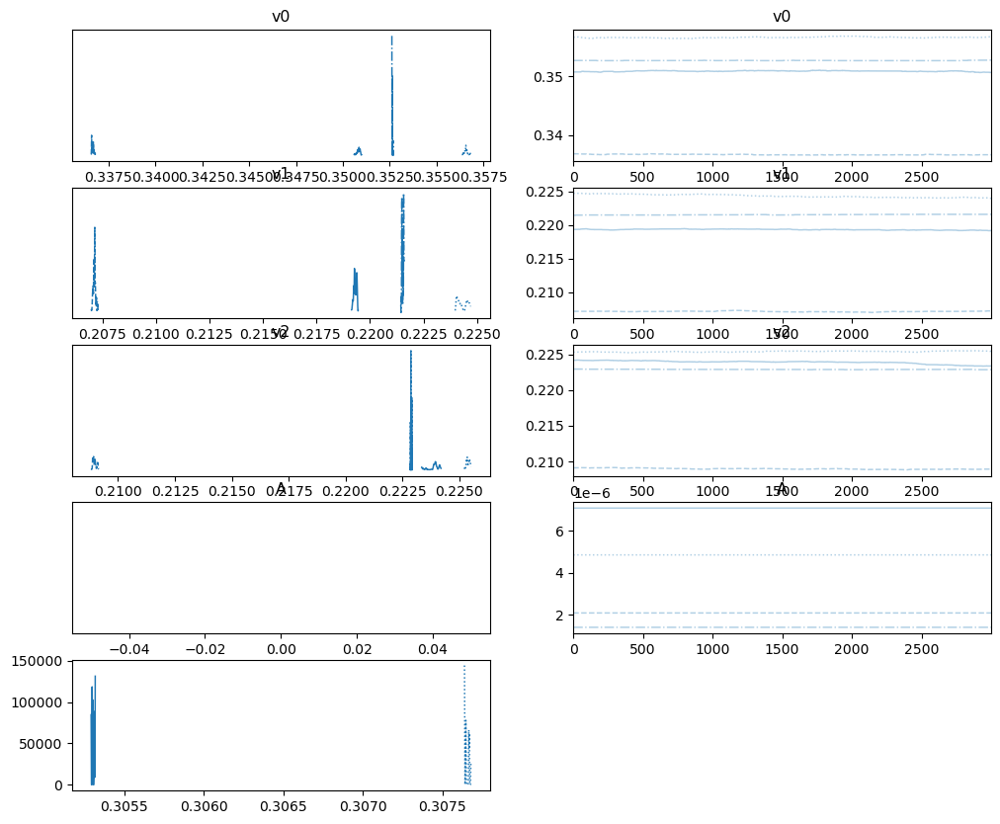

In [7]:
az.plot_trace(
    LBA3_inferenceData,var_names=['v0',
                                         'v1',
                                         'v2',
                                         'A',
                                         'b']
)
plt.tight_layout()

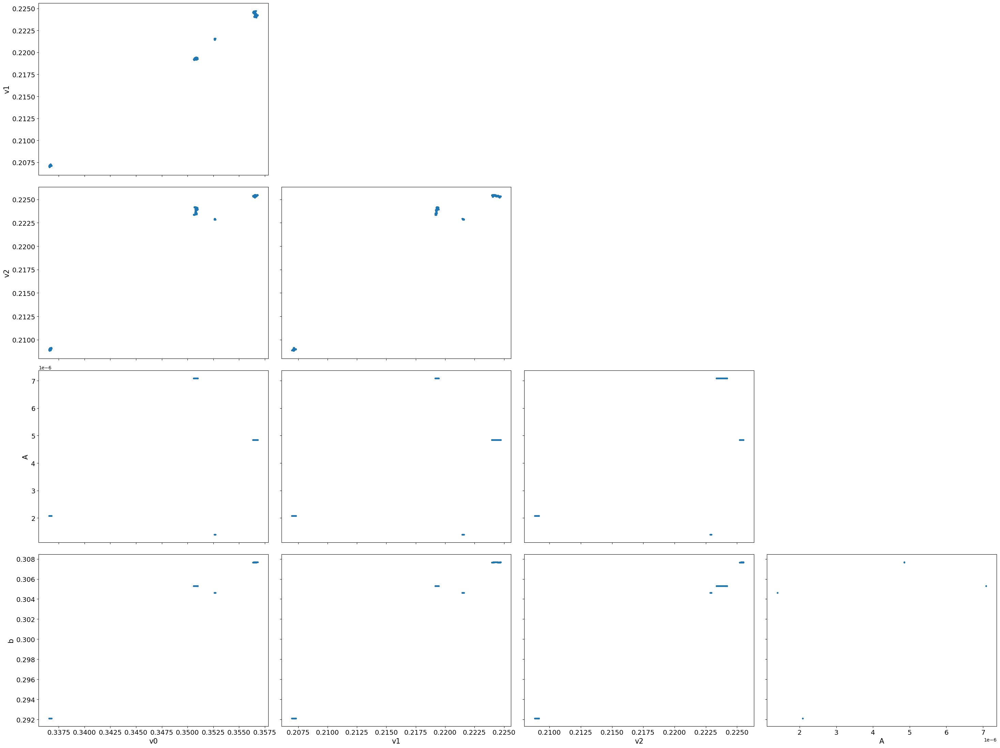

In [8]:
az.plot_pair(
    LBA3_inferenceData,var_names=['v0',
                                         'v1',
                                         'v2',
                                         'A',
                                         'b']
)
plt.tight_layout()

## ddm

In [23]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_simple_allFree_noHier.nc'
ddm_inferenceData=az.from_netcdf(fileName)

In [24]:
ddm_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [25]:
az.summary(ddm_inferenceData,var_names=['v',
                                         'z',
                                         'a',
                                         't'])

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/diagnostics.py:596: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v,0.000,0.0,0.000,0.000,0.0,0.0,6000.0,6000.0,NaN
z,0.500,0.0,0.500,0.500,0.0,0.0,6000.0,6000.0,NaN
a,1.500,0.0,1.500,1.500,0.0,0.0,6000.0,6000.0,NaN
t,0.025,0.0,0.025,0.025,0.0,0.0,6000.0,6000.0,NaN


/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or n

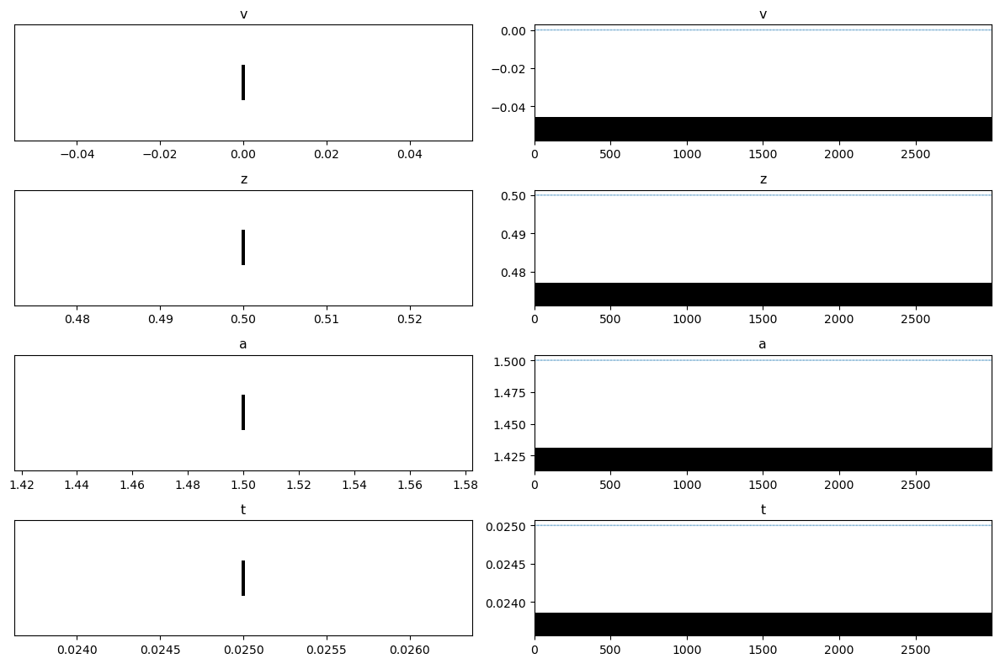

In [26]:
az.plot_trace(
    ddm_inferenceData,var_names=['v',
                                         'z',
                                         'a',
                                         't']
)
plt.tight_layout()

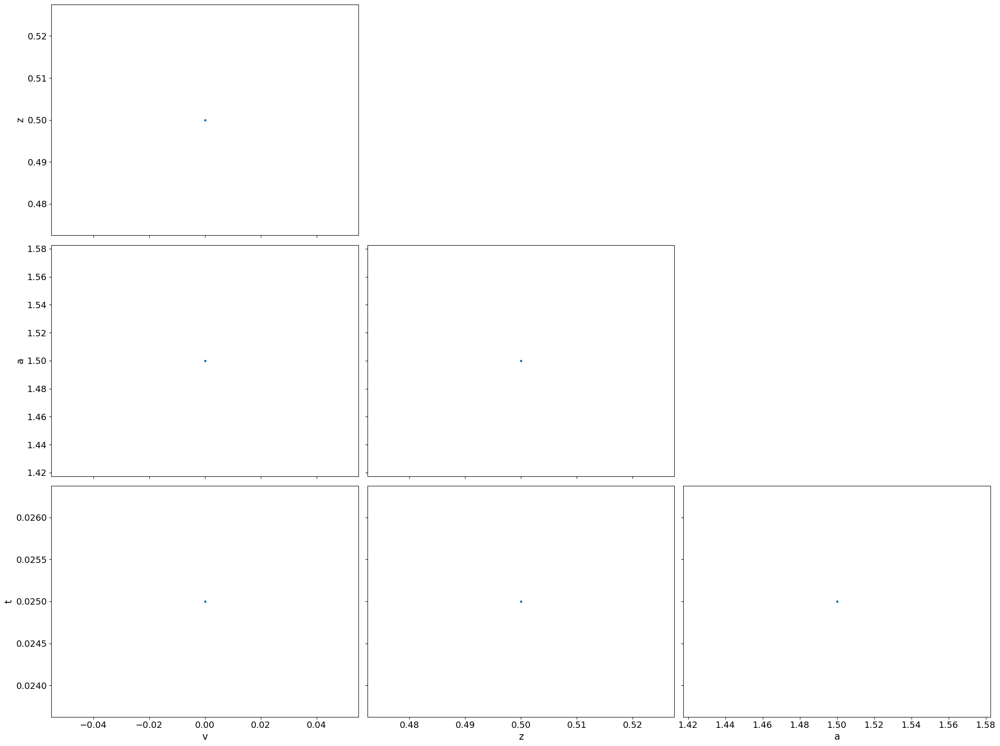

In [27]:
az.plot_pair(
    ddm_inferenceData,var_names=['v',
                                         'z',
                                         'a',
                                         't']
)
plt.tight_layout()

## race

In [28]:
fileName = basepath + '/models/race/sept24/numpyro/inferenceData_simple_race_model_noHier.nc'
race_inferenceData=az.from_netcdf(fileName)

In [29]:
race_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [32]:
from copy import deepcopy
race_idata_test = deepcopy(race_inferenceData)

In [36]:
race_idata_test.posterior['v0_mean'].sel(__obs__=0)

<xarray.DataArray 'v0_mean' (chain: 2, draw: 3000)> Size: 48kB
[6000 values with dtype=float64]
Coordinates:
  * chain    (chain) int64 16B 0 1
  * draw     (draw) int64 24kB 0 1 2 3 4 5 6 ... 2994 2995 2996 2997 2998 2999
    __obs__  int64 8B 0

In [37]:
az.summary(race_idata_test.posterior['v0_mean'].sel(__obs__=0))

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_mean,2.492,0.008,2.477,2.5,0.0,0.0,2431.0,1982.0,1.0


In [38]:
az.summary(race_inferenceData,var_names=['t',
                                         'z',
                                         'v1',
                                         'v2',
                                        ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
t,0.303,0.004,0.296,0.310,0.000,0.0,2402.0,2602.0,1.0
z,0.002,0.002,0.000,0.005,0.000,0.0,3758.0,2192.0,1.0
v1,0.909,0.027,0.860,0.961,0.001,0.0,2737.0,3189.0,1.0
v2,0.934,0.027,0.884,0.985,0.001,0.0,2472.0,2484.0,1.0


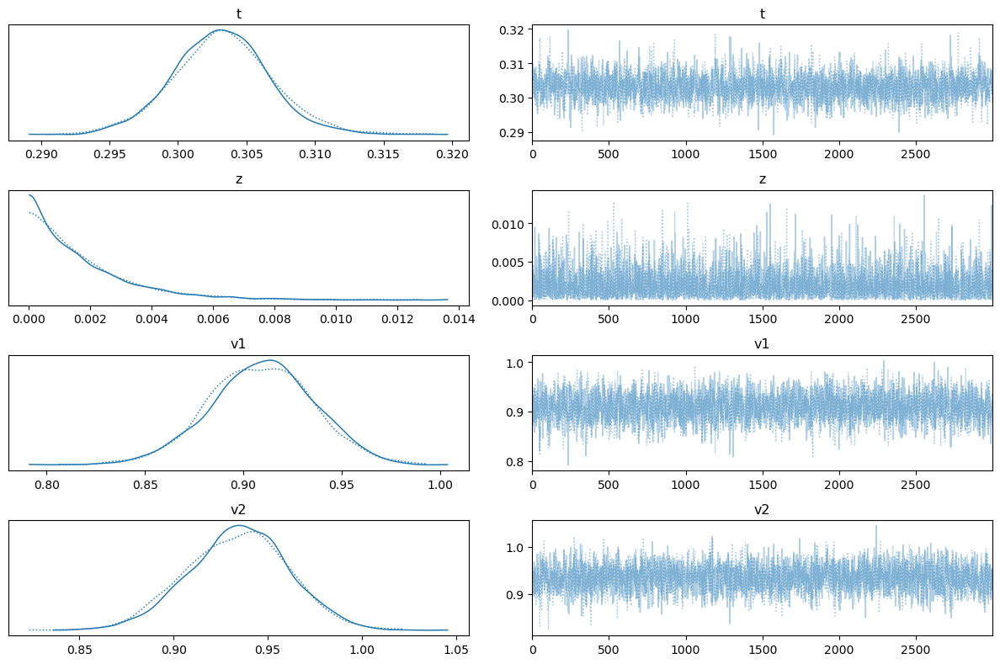

In [40]:
az.plot_trace(
    race_inferenceData,var_names=['t',
                                         'z',
                                         'v1',
                                         'v2',
                                         ]
)
plt.tight_layout()

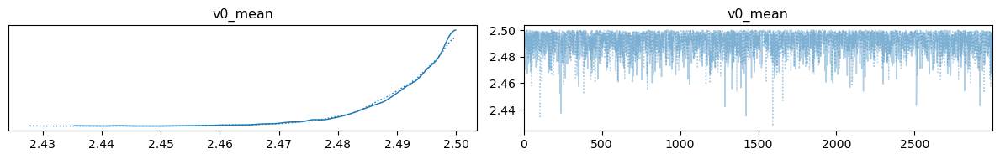

In [41]:
az.plot_trace(
    race_idata_test.posterior['v0_mean'].sel(__obs__=0)
)
plt.tight_layout()

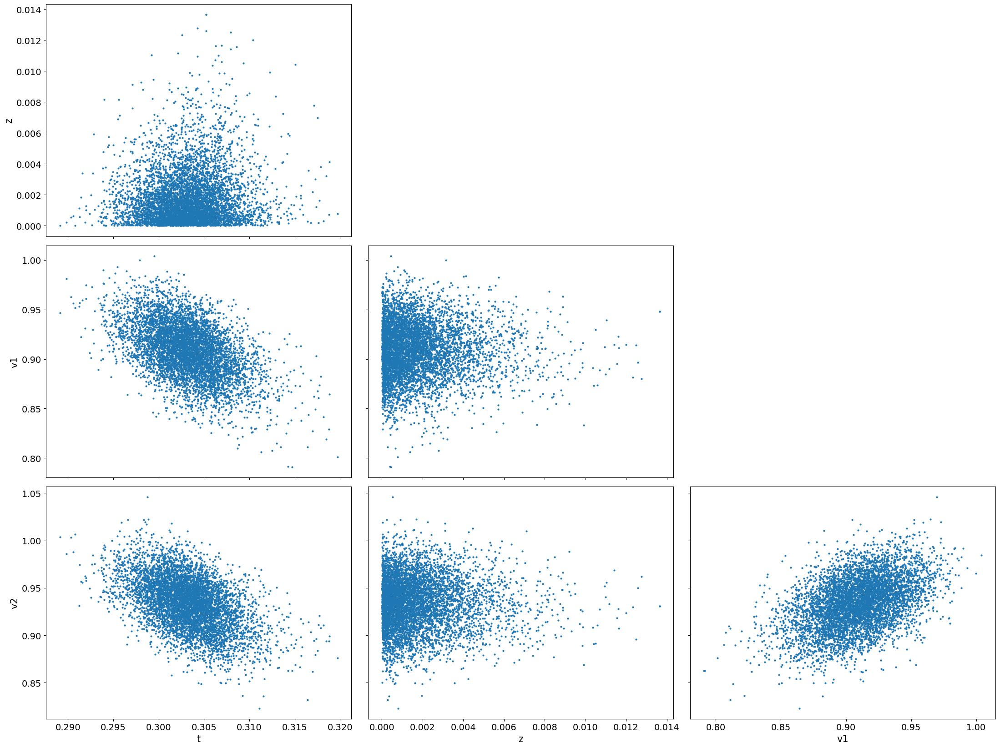

In [42]:
az.plot_pair(
    race_inferenceData,var_names=['t',
                                         'z',
                                         'v1',
                                         'v2',
                                         ]
)
plt.tight_layout()

In [ ]:
az.plot_pair(
    race_inferenceData,var_names=['t',
                                         'z',
                                         'v1',
                                         'v2',
                                         ]
    race_idata_test.posterior['v0_mean'].sel(__obs__=0)
)
plt.tight_layout()

# ddm fixed

## a fixed

In [16]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_.nc'
ddm_inferenceData=az.from_netcdf(fileName)
ddm_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [17]:
az.summary(ddm_inferenceData,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v_Intercept,2.996,0.003,2.991,3.000,0.000,0.000,228.0,513.0,1.01
z_Intercept,0.661,0.013,0.637,0.683,0.004,0.003,9.0,63.0,1.17
t_Intercept,0.495,0.011,0.474,0.514,0.004,0.003,6.0,23.0,1.26


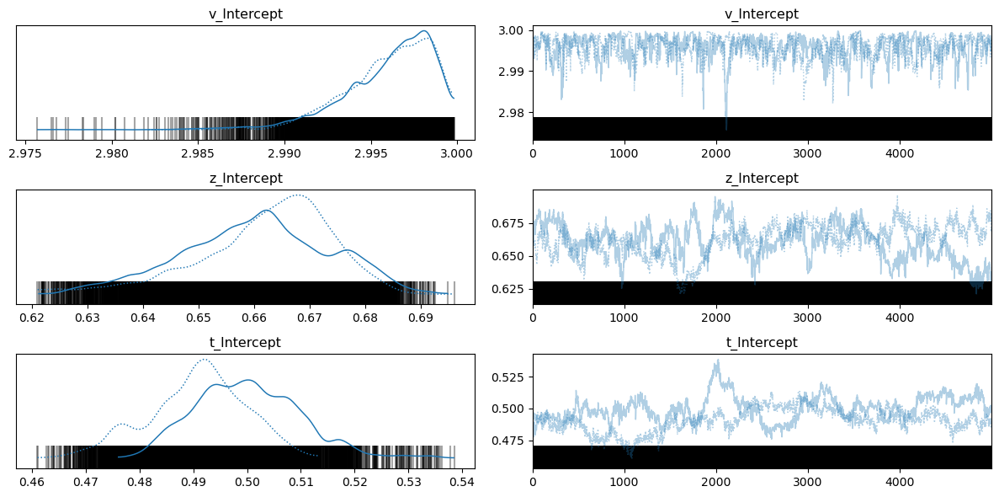

In [18]:
az.plot_trace(
    ddm_inferenceData,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

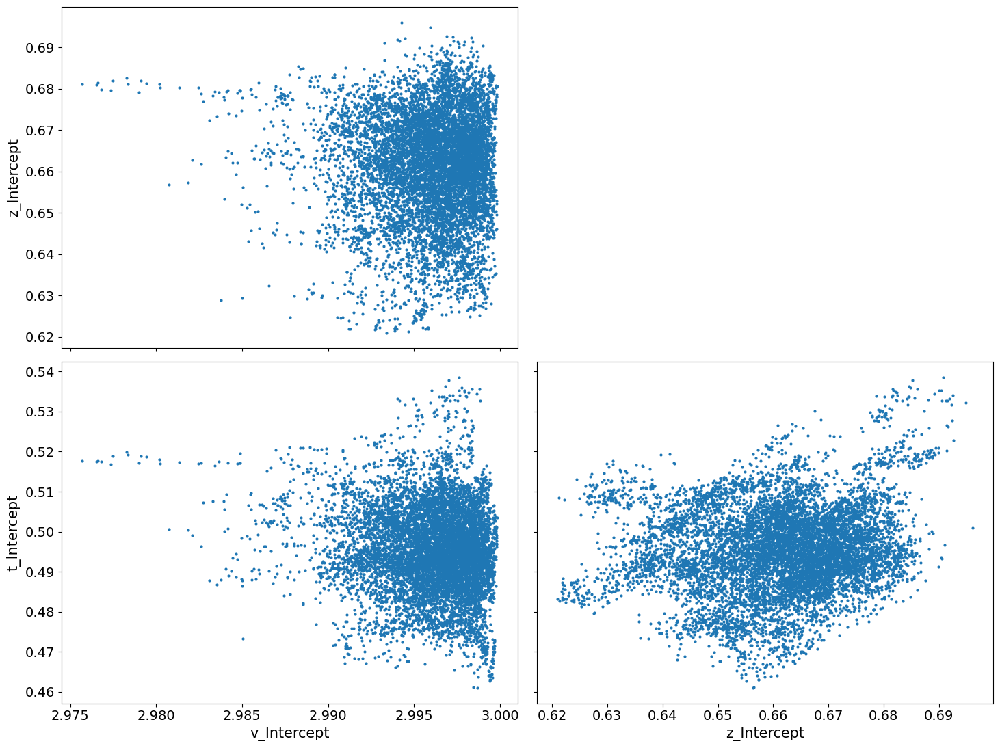

In [19]:
az.plot_pair(
    ddm_inferenceData,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

## z fixed

In [20]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_zFix_.nc'
ddm_inferenceData=az.from_netcdf(fileName)
ddm_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [21]:
az.summary(ddm_inferenceData,var_names=['v_Intercept',
                                         'a_Intercept',
                                         't_Intercept'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v_Intercept,2.963,0.034,2.914,3.000,0.024,0.020,3.0,14.0,2.20
a_Intercept,1.441,0.053,1.368,1.535,0.030,0.023,4.0,21.0,1.54
t_Intercept,0.395,0.070,0.298,0.484,0.049,0.041,2.0,11.0,2.34


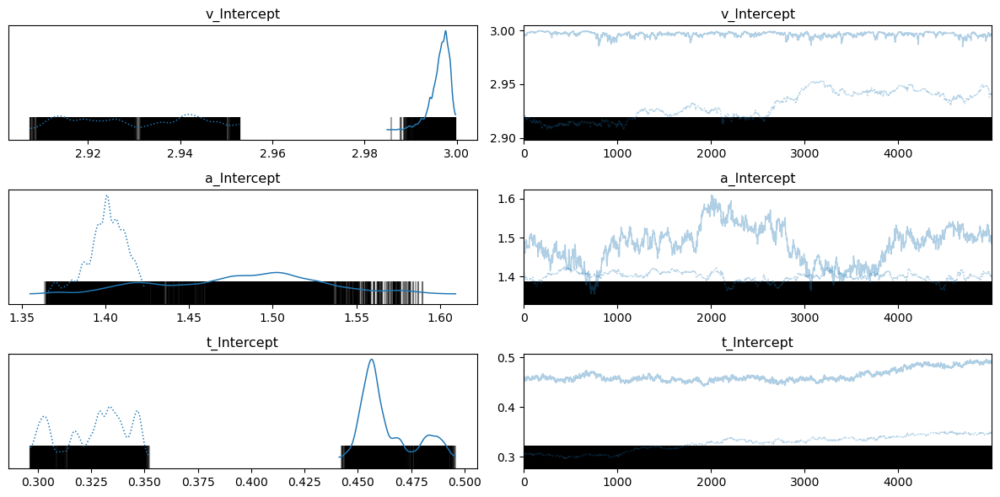

In [22]:
az.plot_trace(
    ddm_inferenceData,var_names=['v_Intercept',
                                         'a_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

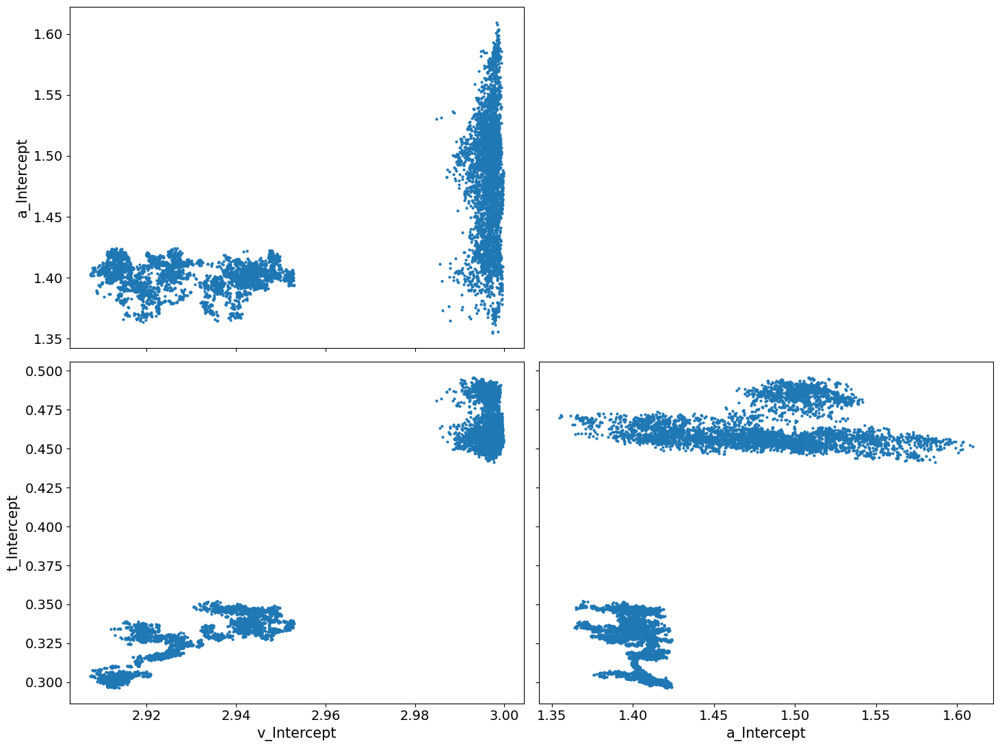

In [23]:
az.plot_pair(
    ddm_inferenceData,var_names=['v_Intercept',
                                         'a_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

## compare

In [29]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_.nc'
ddm_inferenceData_aFix=az.from_netcdf(fileName)
ddm_inferenceData_aFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [25]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_zFix_.nc'
ddm_inferenceData_zFix=az.from_netcdf(fileName)
ddm_inferenceData_zFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [26]:
compare_data = az.compare(
    {
        "a_fixed": ddm_inferenceData_aFix,
        "z_fixed": ddm_inferenceData_zFix,
    }
)

compare_data

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hss

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
a_fixed,0,3552.933631,188.296459,0.000000,0.927288,112.634738,0.000000,True,log
z_fixed,1,3398.630321,215.834817,154.303311,0.072712,104.971222,17.931499,True,log


# Race fixed

## a fixed

In [3]:
fileName = basepath + '/models/race/sept24/numpyro/inferenceData_race_trialDepend_aFix.nc'
race_inferenceData=az.from_netcdf(fileName)
race_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [4]:
az.summary(race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'z_Intercept',
                                         't_Intercept'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_Intercept,0.010,0.016,0.005,0.010,0.004,0.003,39.0,16.0,1.09
v1_Intercept,0.006,0.001,0.004,0.009,0.001,0.001,4.0,25.0,1.49
v2_Intercept,0.006,0.001,0.005,0.008,0.001,0.000,3.0,13.0,1.75
z_Intercept,0.021,0.022,0.006,0.041,0.011,0.008,3.0,11.0,2.26
t_Intercept,0.026,0.000,0.025,0.026,0.000,0.000,3.0,11.0,1.91


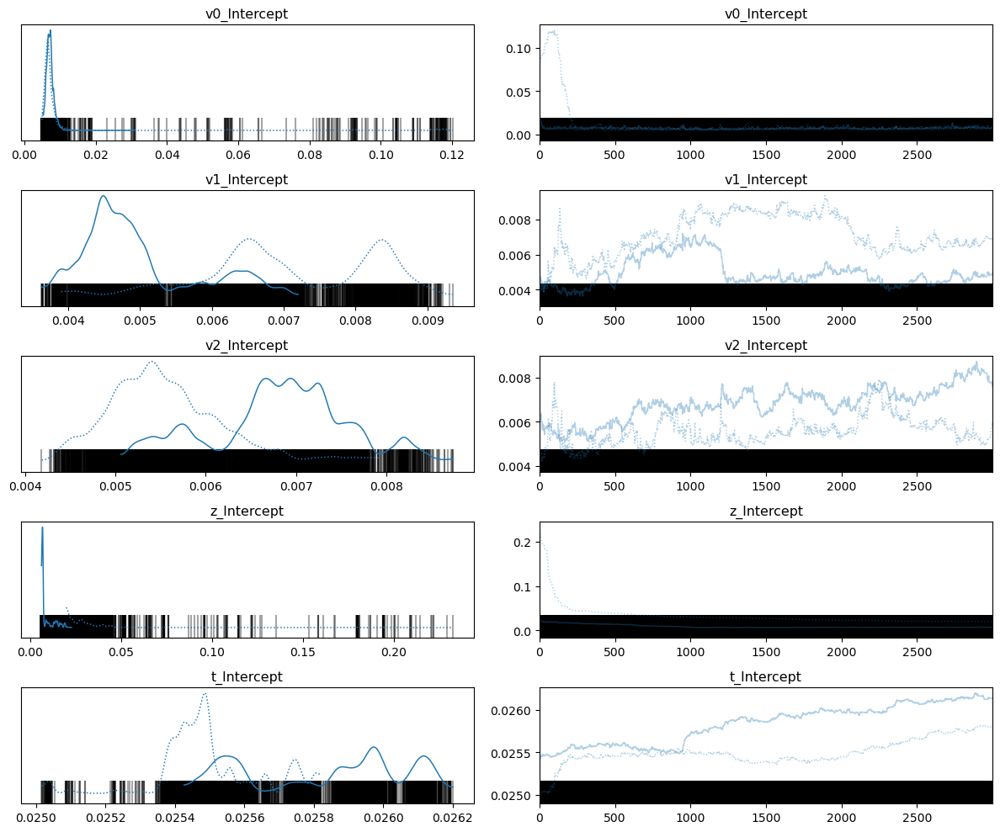

In [5]:
az.plot_trace(
    race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'z_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

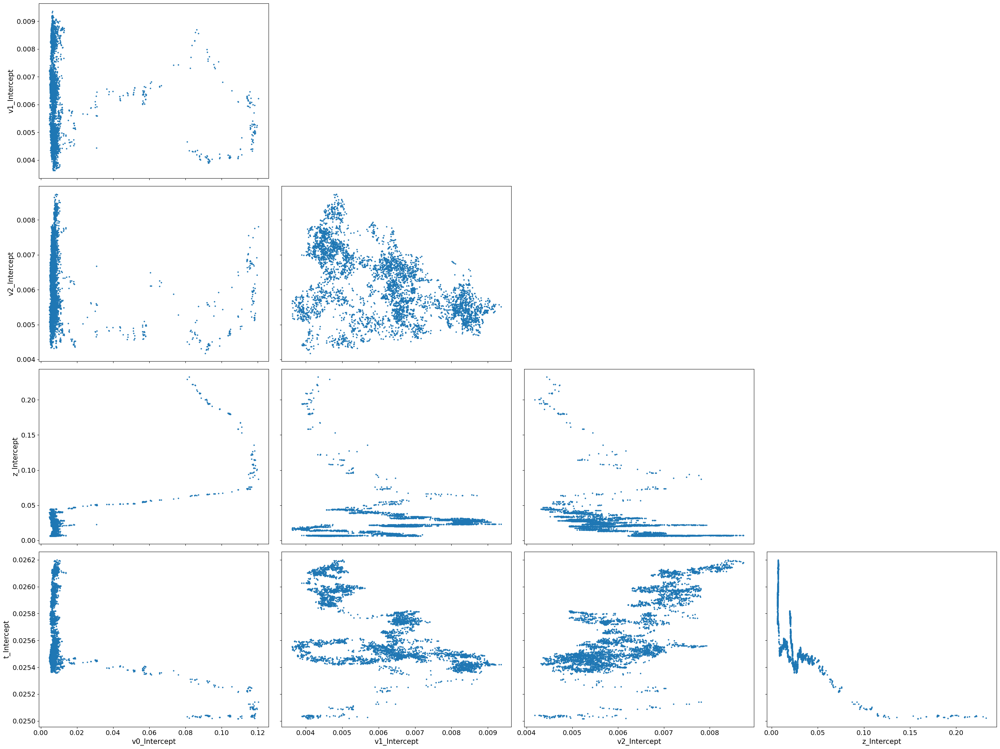

In [6]:
az.plot_pair(
    race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'z_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

## z fixed

In [7]:
fileName = basepath + '/models/race/sept24/numpyro/inferenceData_race_trialDepend_zFix.nc'
race_inferenceData=az.from_netcdf(fileName)
race_inferenceData

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [8]:
az.summary(race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'a_Intercept',
                                         't_Intercept'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_Intercept,0.014,0.005,0.009,0.023,0.003,0.002,3.0,23.0,2.22
v1_Intercept,0.046,0.039,0.008,0.095,0.026,0.021,4.0,22.0,2.11
v2_Intercept,0.116,0.112,0.012,0.270,0.076,0.063,3.0,11.0,2.96
a_Intercept,2.244,0.124,2.197,2.333,0.054,0.043,2.0,11.0,2.61
t_Intercept,0.026,0.001,0.025,0.027,0.001,0.000,3.0,12.0,2.24


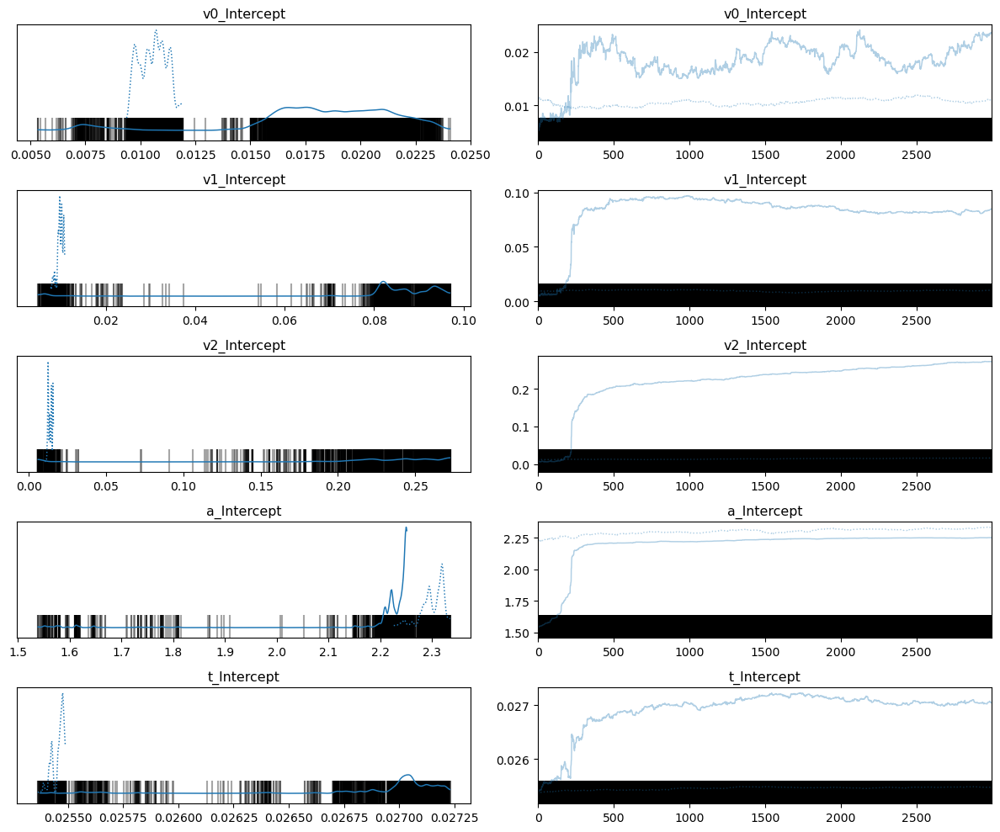

In [9]:
az.plot_trace(
    race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'a_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

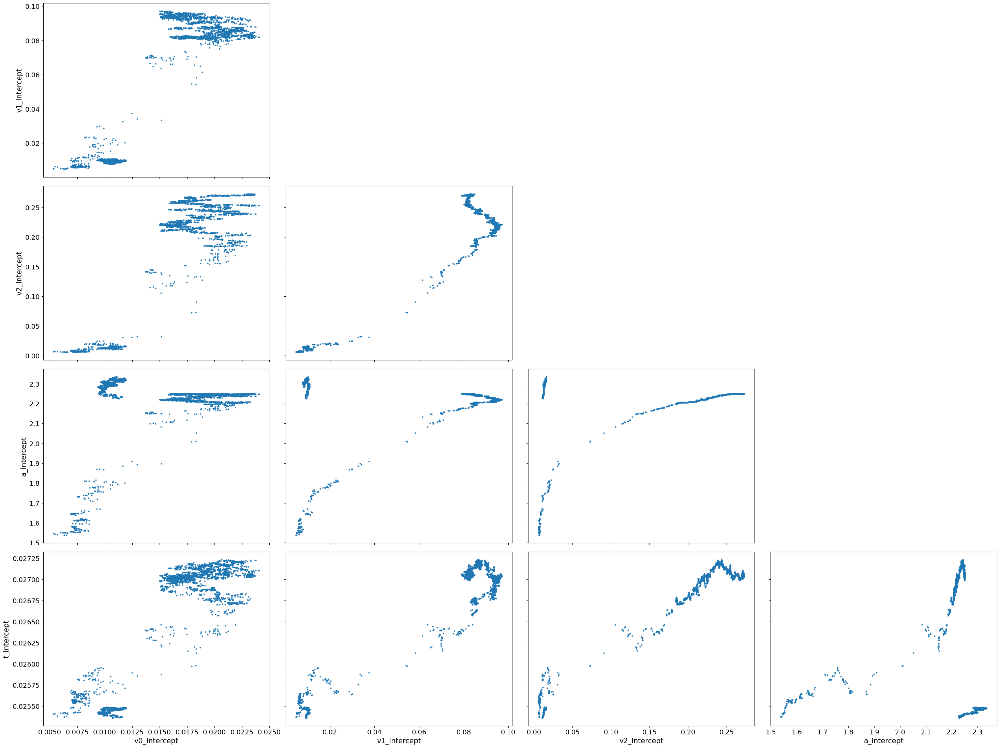

In [10]:
az.plot_pair(
    race_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'a_Intercept',
                                         't_Intercept']
)
plt.tight_layout()

## compare

In [11]:
fileName = basepath + '/models/race/sept24/numpyro/inferenceData_race_trialDepend_aFix.nc'
race_inferenceData_aFix=az.from_netcdf(fileName)
race_inferenceData_aFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [12]:
fileName = basepath + '/models/race/sept24/numpyro/inferenceData_race_trialDepend_zFix.nc'
race_inferenceData_zFix=az.from_netcdf(fileName)
race_inferenceData_zFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [13]:
compare_data = az.compare(
    {
        "a_fixed": race_inferenceData_aFix,
        "z_fixed": race_inferenceData_zFix,
    }
)

compare_data

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hss

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
z_fixed,0,-3001.498095,135.684806,0.000000,1.000000e+00,94.770005,0.000000,True,log
a_fixed,1,-10930.896477,17.069947,7929.398382,5.808687e-13,96.451246,40.860861,True,log


# LBA fixed

## A fixed

In [16]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier_Afix.nc'
lba_inferenceData=az.from_netcdf(fileName)
lba_inferenceData


Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [17]:
az.summary(lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_Intercept,0.327,0.017,0.298,0.359,0.005,0.004,10.0,42.0,1.15
v1_Intercept,0.208,0.019,0.174,0.246,0.004,0.003,25.0,37.0,1.08
v2_Intercept,0.210,0.024,0.167,0.253,0.010,0.008,5.0,26.0,1.34
b_Intercept,0.789,0.013,0.764,0.807,0.007,0.005,4.0,25.0,1.41


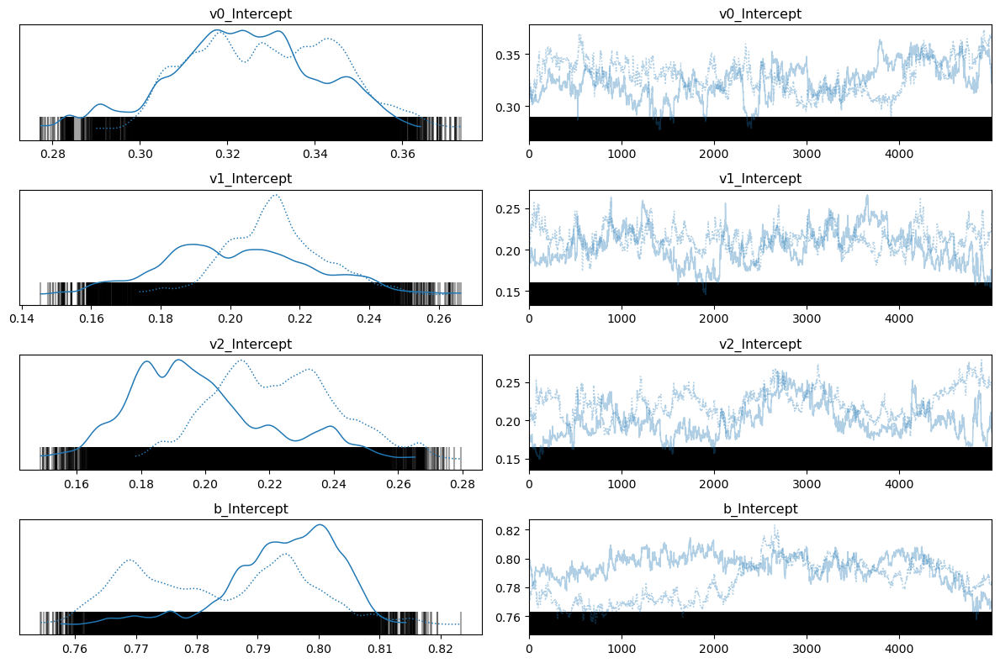

In [18]:
az.plot_trace(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         ]
)
plt.tight_layout()

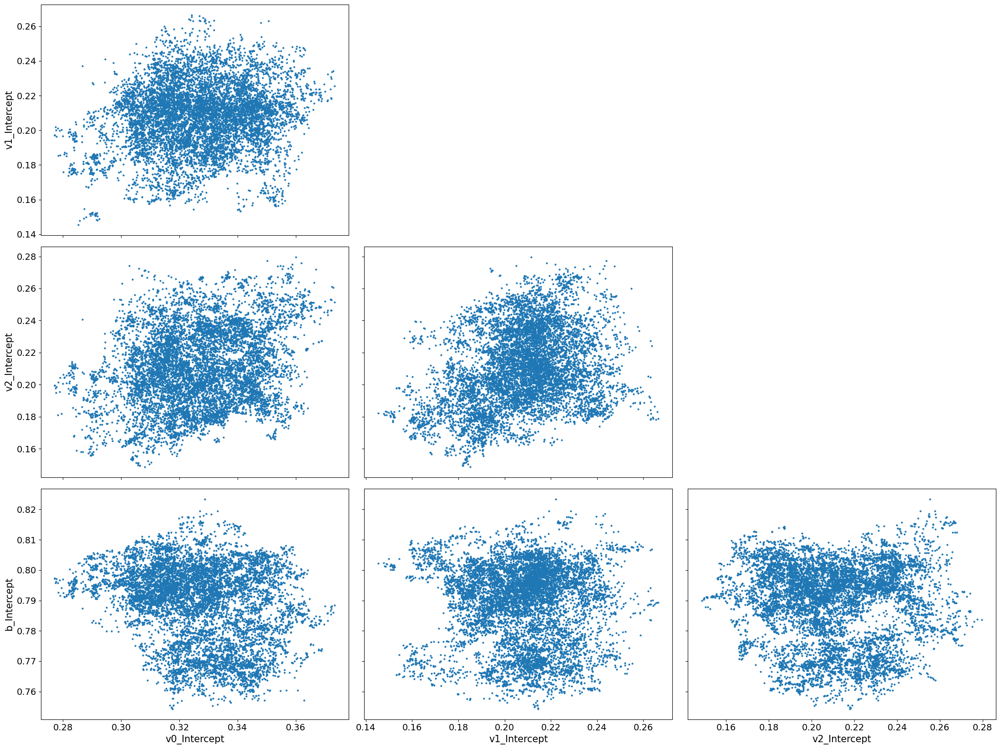

In [19]:
az.plot_pair(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         ]
)
plt.tight_layout()

## b fixed

In [20]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier_bfix.nc'
lba_inferenceData=az.from_netcdf(fileName)
lba_inferenceData


Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [21]:
az.summary(lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_Intercept,0.805,0.072,0.704,0.904,0.050,0.042,2.0,11.0,2.86
v1_Intercept,0.328,0.016,0.313,0.345,0.011,0.009,3.0,13.0,2.21
v2_Intercept,0.462,0.086,0.376,0.552,0.061,0.051,2.0,12.0,2.63
A_Intercept,0.467,0.107,0.360,0.574,0.076,0.064,2.0,11.0,2.63


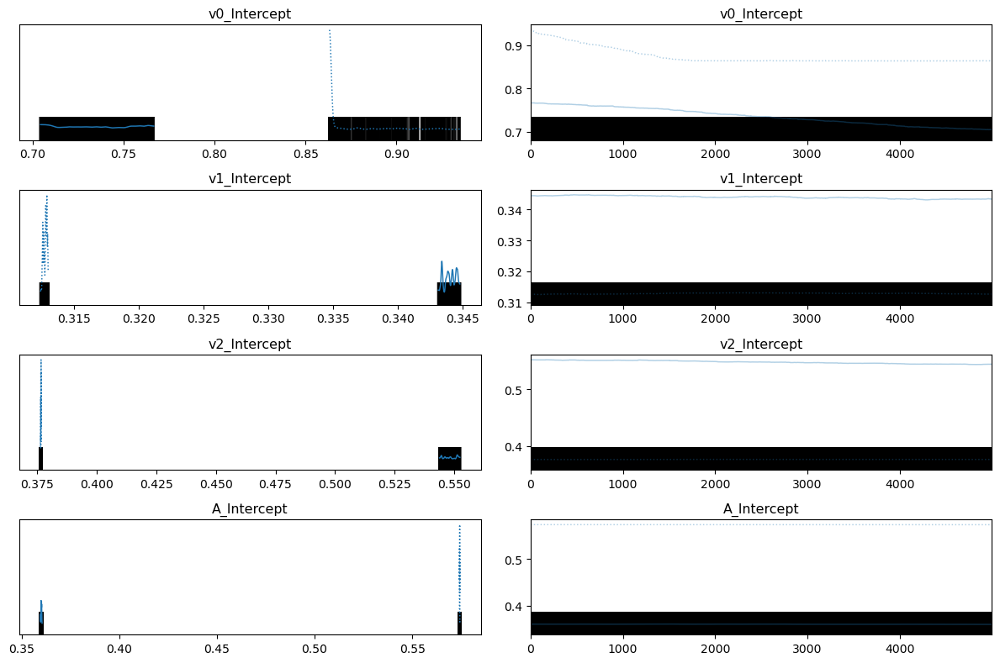

In [22]:
az.plot_trace(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         ]
)
plt.tight_layout()

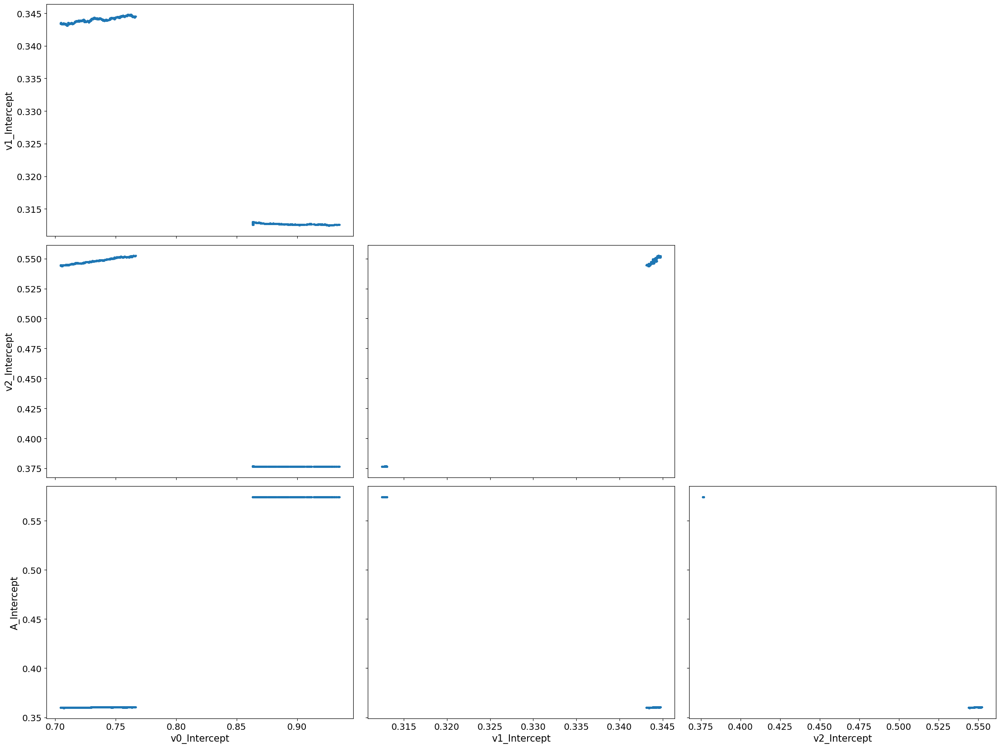

In [23]:
az.plot_pair(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         ]
)
plt.tight_layout()

## no fix

In [26]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier_.nc'
lba_inferenceData=az.from_netcdf(fileName)
lba_inferenceData

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

In [27]:
az.summary(lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         'b_Intercept'
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v0_Intercept,0.431,0.050,0.359,0.475,0.034,0.028,2.0,11.0,3.68
v1_Intercept,0.443,0.031,0.406,0.473,0.022,0.018,2.0,11.0,3.64
v2_Intercept,0.129,0.019,0.110,0.150,0.013,0.011,2.0,2.0,3.30
A_Intercept,0.241,0.046,0.195,0.288,0.033,0.028,3.0,2.0,2.24
b_Intercept,0.246,0.008,0.239,0.254,0.006,0.005,2.0,24.0,3.61


/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or n

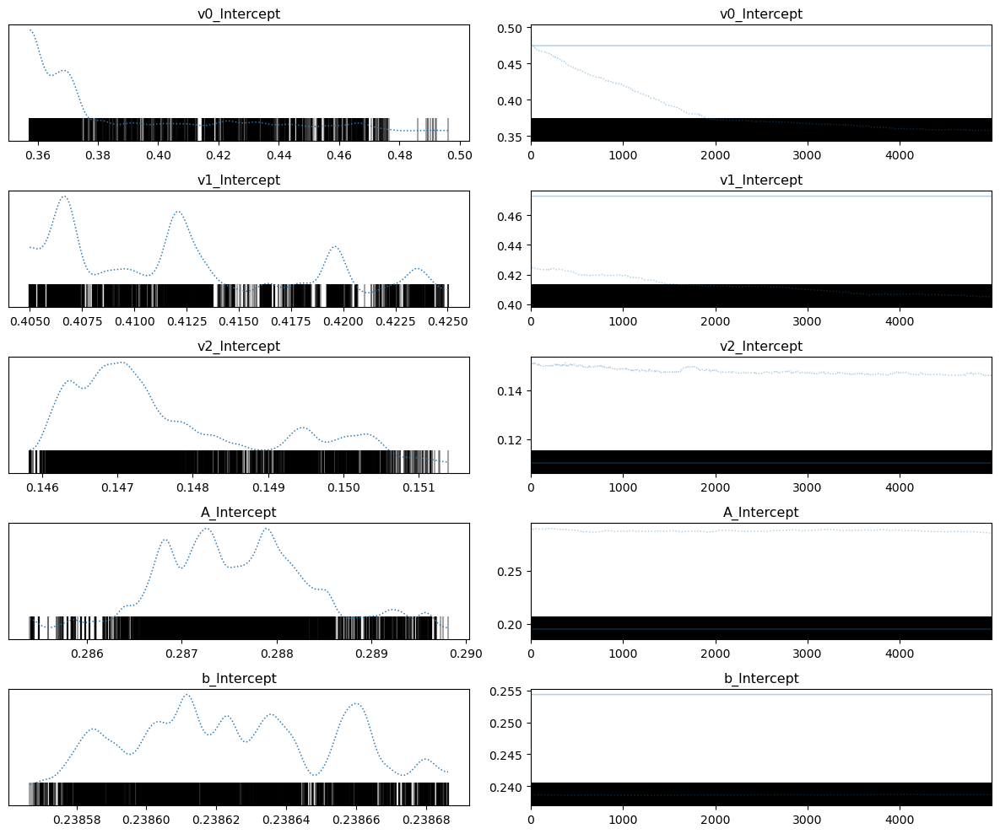

In [28]:
az.plot_trace(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         'b_Intercept'
                                         ]
)
plt.tight_layout()

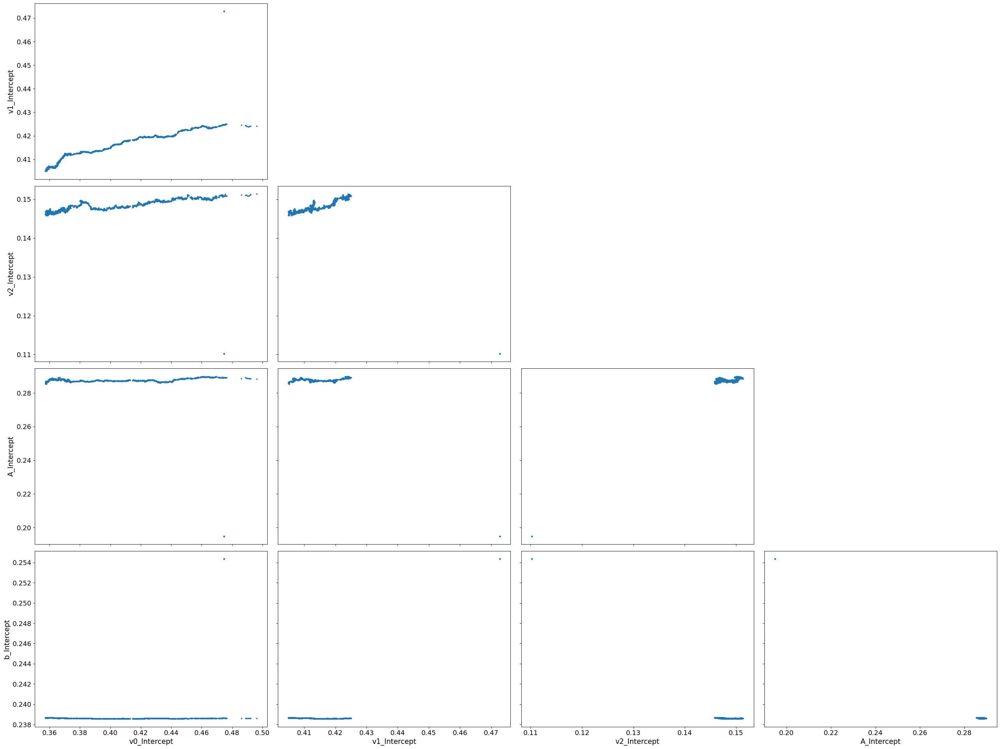

In [29]:
az.plot_pair(
    lba_inferenceData,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'A_Intercept',
                                         'b_Intercept'
                                         ]
)
plt.tight_layout()

## compare

In [14]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier_Afix.nc'
lba_inferenceData_AFix=az.from_netcdf(fileName)
lba_inferenceData_AFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [32]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier_bfix.nc'
lba_inferenceData_bFix=az.from_netcdf(fileName)
lba_inferenceData_bFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [34]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_simple_LBA_model_trialDepend_hier.nc'
lba_inferenceData_noFix=az.from_netcdf(fileName)
lba_inferenceData_noFix

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [35]:
compare_data = az.compare(
    {
        "A_fixed": lba_inferenceData_AFix,
        "b_fixed": lba_inferenceData_bFix,
        "noFix" : lba_inferenceData_noFix
    }
)

compare_data

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hss

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
A_fixed,0,4798.680569,239.245118,0.000000,1.000000e+00,1.166625e+02,0.000000,True,log
b_fixed,1,-66888.710038,0.000000,71687.390607,0.000000e+00,9.384478e-14,116.662530,True,log
noFix,2,-163283.259500,39100.020210,168081.940069,2.401412e-13,2.217390e+03,2218.549968,True,log


# compare all fixed models

In [30]:
compare_data = az.compare(
    {
        "ddm_a_fixed": ddm_inferenceData_aFix,
        "race_z_fixed": race_inferenceData_zFix,
        "lba_A_fixed": lba_inferenceData_AFix,
    }
)

compare_data

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hss

ValueError: The number of observations should be the same across all models

In [31]:
compare_data = az.compare(
    {
        
        "race_z_fixed": race_inferenceData_zFix,
        "lba_A_fixed": lba_inferenceData_AFix,
    }
)

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hss

In [32]:
compare_data

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
lba_A_fixed,0,4798.680569,239.245118,0.000000,0.99171,116.662530,0.000000,True,log
race_z_fixed,1,-4306.536748,134.467606,9105.217317,0.00829,139.507382,122.184639,True,log


# neural covariates

## ddm

### z depends no subject offset

In [36]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_bias_neuralCovariates_noOffset.nc'
ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet=az.from_netcdf(fileName)
ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [33]:
az.summary(ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_trl_condition'
                                         
                                         ])

NameError: name 'ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet' is not defined

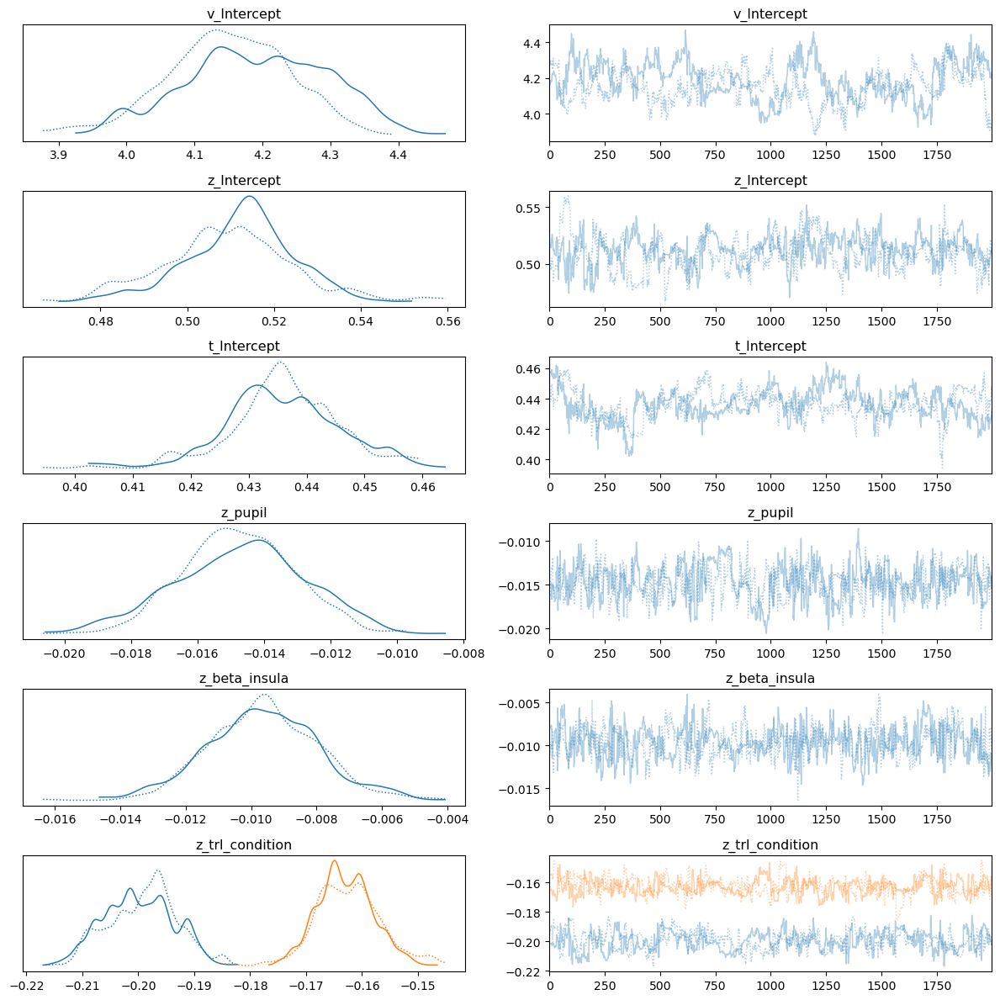

In [38]:
az.plot_trace(
    ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_trl_condition'
                                         
                                         ],
                                         divergences=None
)
plt.tight_layout()

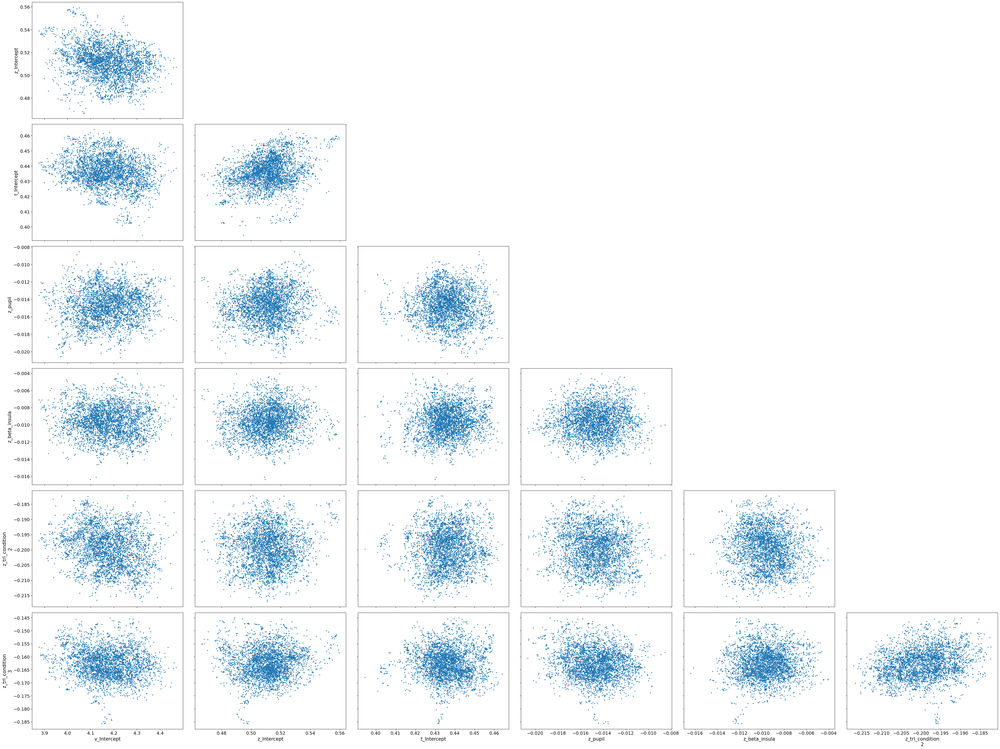

In [39]:
az.plot_pair(
    ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_trl_condition'
                                         
                                         ]
)
plt.tight_layout()

### z depends with subject offset

In [3]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_bias_neuralCovariates_offSet.nc'
ddm_inferenceData_aFix_bias_neuralCovariates=az.from_netcdf(fileName)
ddm_inferenceData_aFix_bias_neuralCovariates

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [34]:
s=az.summary(ddm_inferenceData_aFix_bias_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil|participant_id',
                                         'z_beta_insula|participant_id',
                                         'z_trl_condition|participant_id'
                                         
                                         ])

In [36]:
s.r_hat.mean()

1.1568292682926828

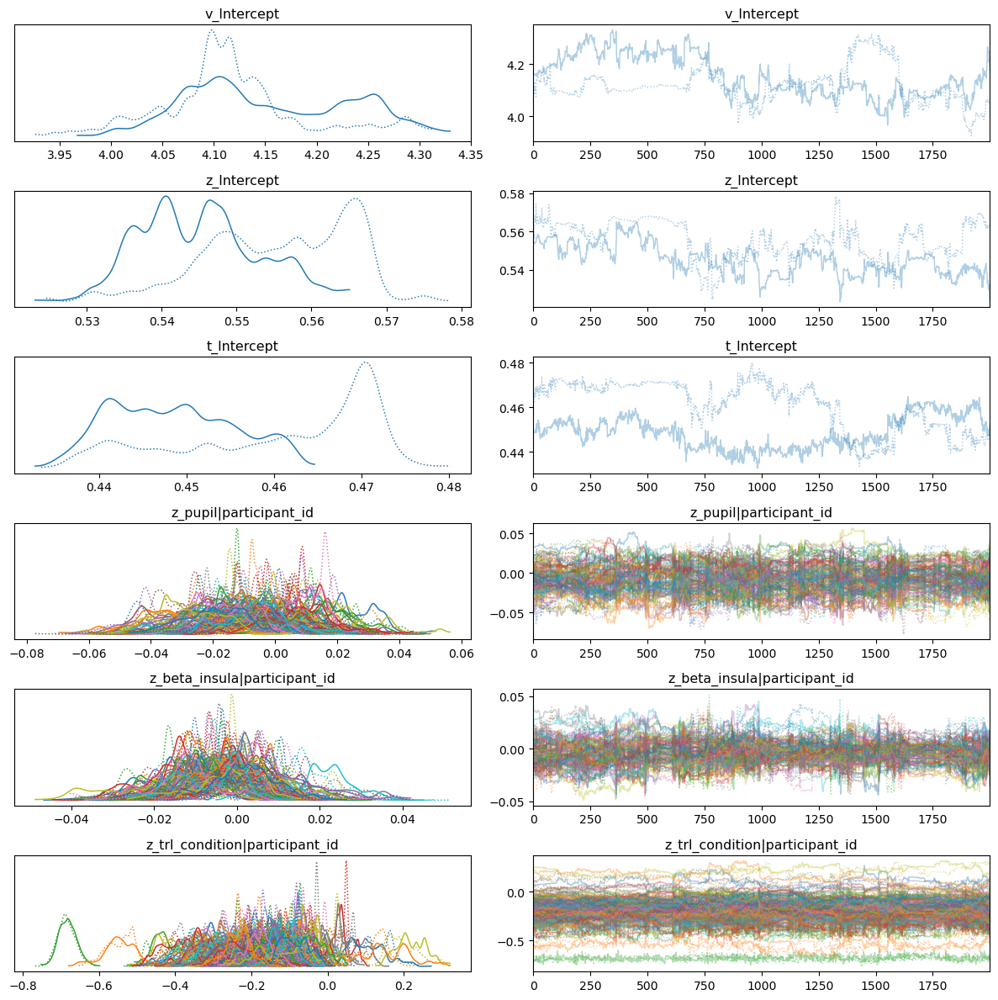

In [42]:
az.plot_trace(
    ddm_inferenceData_aFix_bias_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil|participant_id',
                                         'z_beta_insula|participant_id',
                                         'z_trl_condition|participant_id'
                                         
                                         ],
                                         divergences=None
)
plt.tight_layout()

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/plots/backends/matplotlib/pairplot.py:233: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


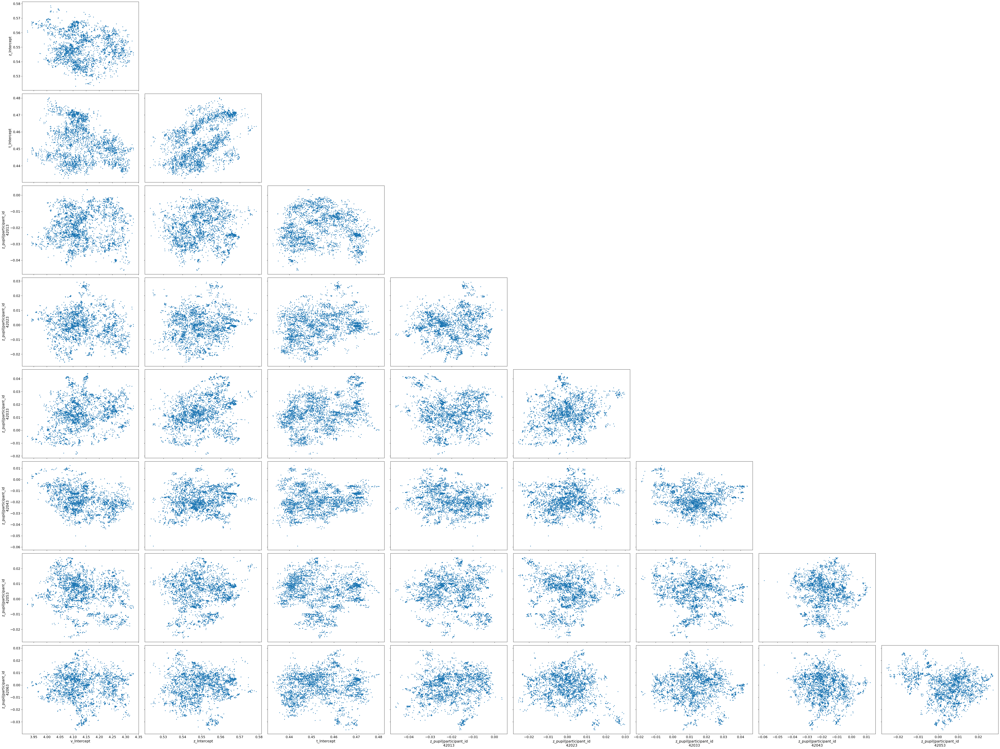

In [43]:
az.plot_pair(
    ddm_inferenceData_aFix_bias_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil|participant_id',
                                         'z_beta_insula|participant_id',
                                         'z_trl_condition|participant_id'
                                         
                                         ]
)
plt.tight_layout()

### v depends no subject offset

In [44]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_driftRate_neuralCovariates_noOffset.nc'
ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet=az.from_netcdf(fileName)
ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [45]:
az.summary(ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil',
                                         'v_beta_insula',
                                         'v_trl_condition'
                                         
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v_Intercept,2.238,0.338,1.619,2.874,0.014,0.010,581.0,611.0,1.0
z_Intercept,0.360,0.019,0.325,0.396,0.001,0.000,1383.0,1035.0,1.0
t_Intercept,0.381,0.012,0.359,0.406,0.000,0.000,843.0,1563.0,1.0
v_pupil,-0.140,0.014,-0.167,-0.114,0.000,0.000,2312.0,1764.0,1.0
v_beta_insula,-0.129,0.014,-0.157,-0.104,0.000,0.000,2873.0,1849.0,1.0
v_trl_condition[2],-1.187,0.040,-1.262,-1.112,0.001,0.001,2615.0,2566.0,1.0
v_trl_condition[3],-0.953,0.040,-1.029,-0.879,0.001,0.001,1926.0,1367.0,1.0


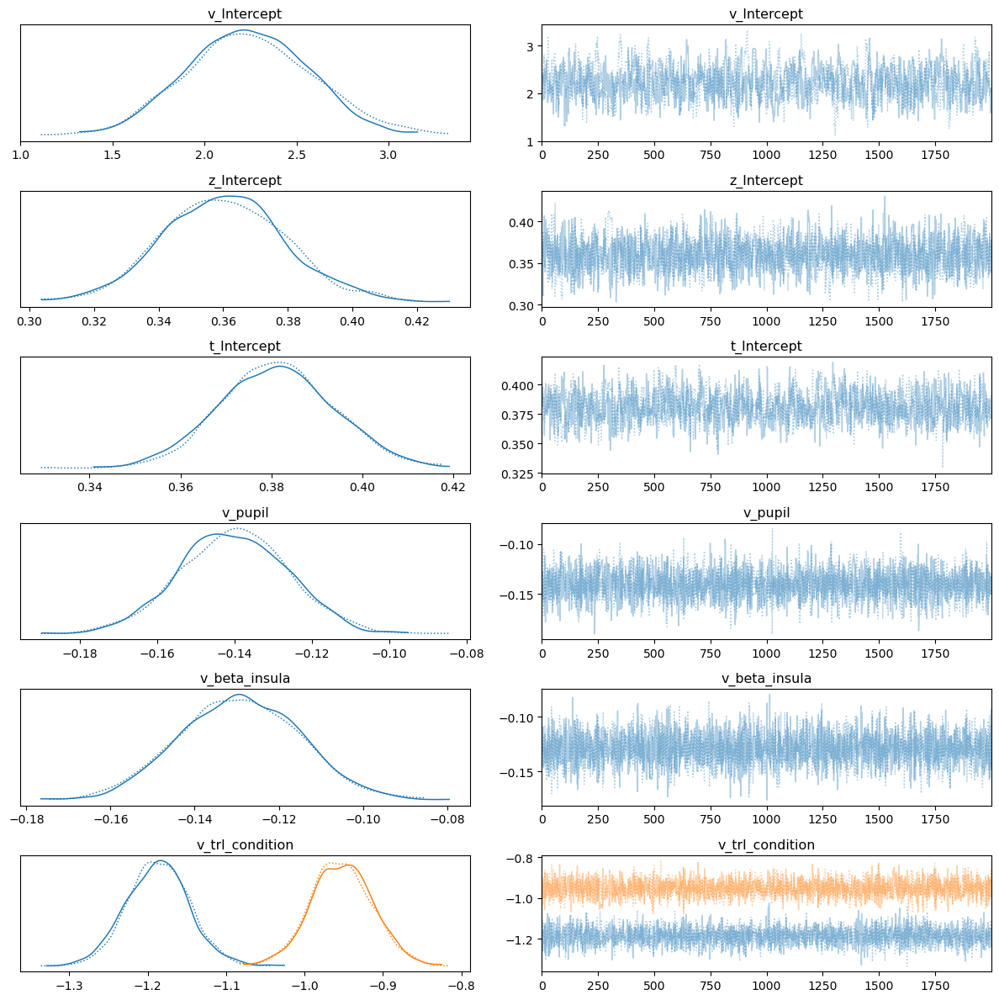

In [46]:
az.plot_trace(
    ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil',
                                         'v_beta_insula',
                                         'v_trl_condition'
                                         
                                         ],
                                         divergences=None
)
plt.tight_layout()

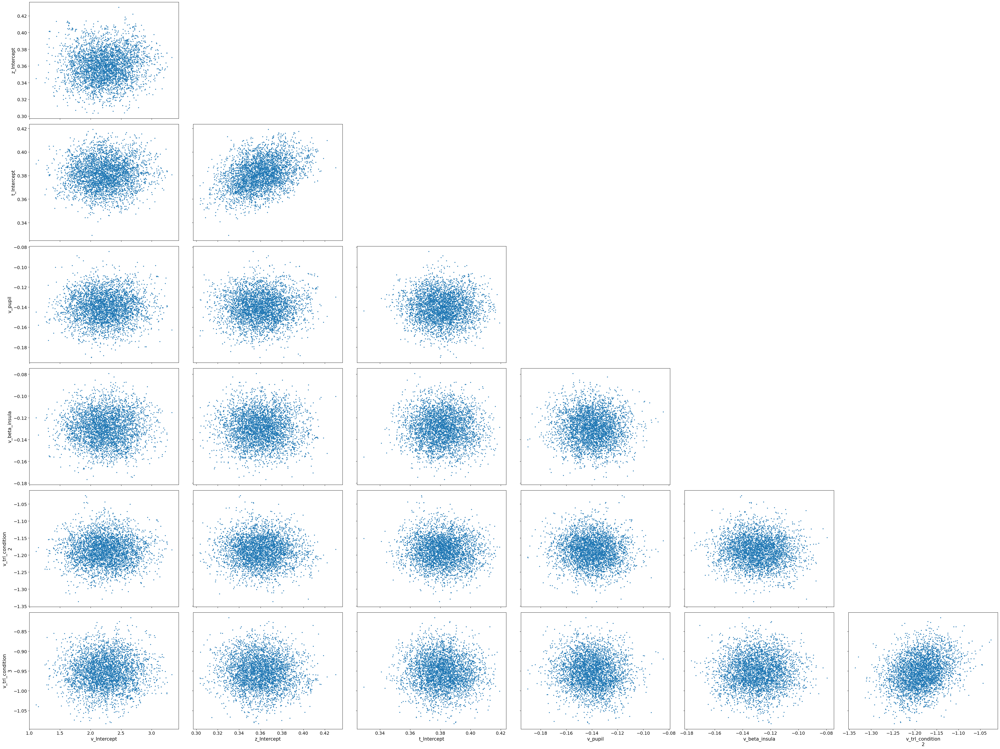

In [47]:
az.plot_pair(
    ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil',
                                         'v_beta_insula',
                                         'v_trl_condition'
                                         
                                         ]
)
plt.tight_layout()

### v depends subject offset

In [48]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_driftRate_neuralCovariates_offSet.nc'
ddm_inferenceData_aFix_driftRate_neuralCovariates=az.from_netcdf(fileName)
ddm_inferenceData_aFix_driftRate_neuralCovariates

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [49]:
az.summary(ddm_inferenceData_aFix_driftRate_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil|participant_id',
                                         'v_beta_insula|participant_id',
                                         'v_trl_condition|participant_id'
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v_Intercept,2.064,0.316,1.479,2.654,0.018,0.013,327.0,582.0,1.01
z_Intercept,0.329,0.019,0.294,0.364,0.001,0.000,732.0,951.0,1.01
t_Intercept,0.375,0.012,0.352,0.397,0.001,0.000,512.0,917.0,1.01
v_pupil|participant_id[42013],-0.227,0.105,-0.427,-0.043,0.002,0.001,2528.0,2072.0,1.00
v_pupil|participant_id[42023],-0.137,0.113,-0.355,0.072,0.002,0.002,3300.0,1771.0,1.00
...,...,...,...,...,...,...,...,...,...
"v_trl_condition|participant_id[3, 62403]",-1.544,0.316,-2.106,-0.927,0.007,0.005,1885.0,1678.0,1.00
"v_trl_condition|participant_id[3, 62413]",-0.526,0.278,-1.065,-0.031,0.006,0.004,2504.0,2533.0,1.00
"v_trl_condition|participant_id[3, 62423]",-0.688,0.316,-1.280,-0.095,0.006,0.004,2772.0,1882.0,1.00
"v_trl_condition|participant_id[3, 62433]",-0.439,0.350,-1.074,0.245,0.006,0.005,2944.0,2304.0,1.00


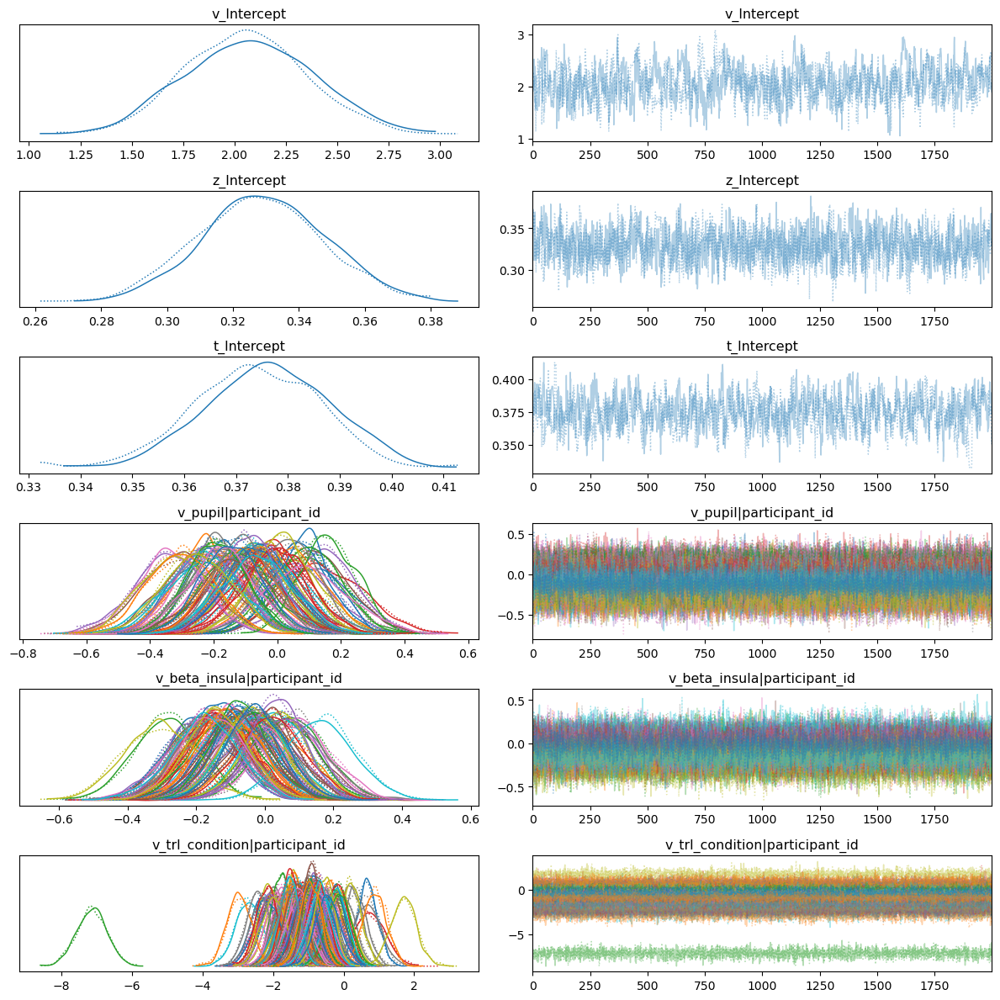

In [50]:
az.plot_trace(
    ddm_inferenceData_aFix_driftRate_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil|participant_id',
                                         'v_beta_insula|participant_id',
                                         'v_trl_condition|participant_id'
                                         ],
                                         divergences=None
)
plt.tight_layout()

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/plots/backends/matplotlib/pairplot.py:233: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


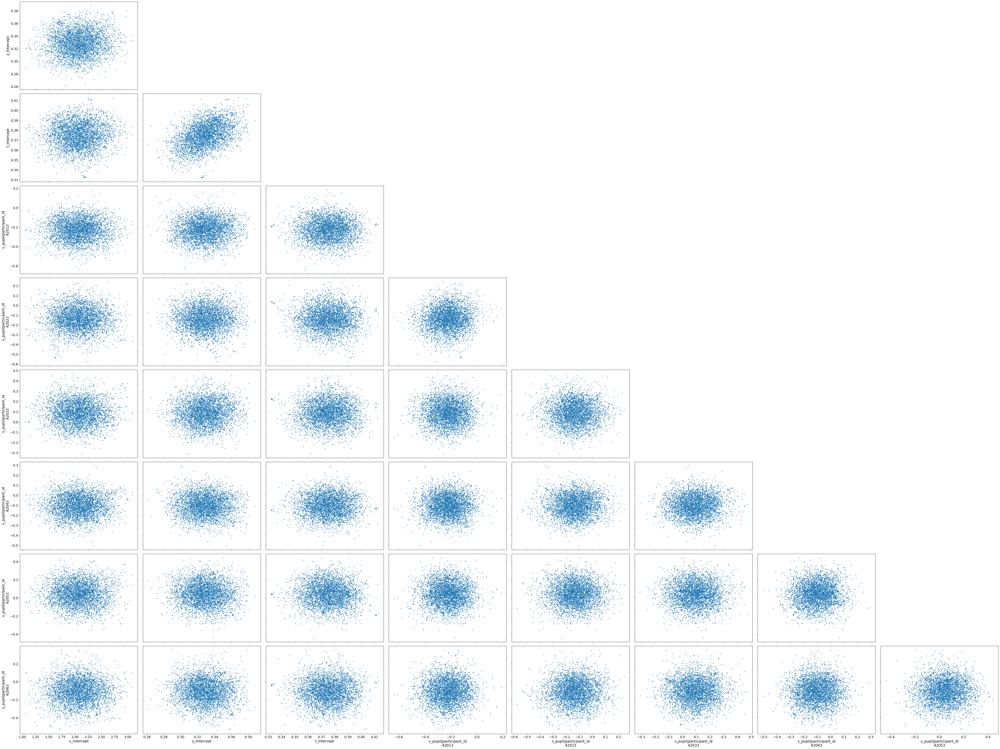

In [51]:
az.plot_pair(
    ddm_inferenceData_aFix_driftRate_neuralCovariates,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'v_pupil|participant_id',
                                         'v_beta_insula|participant_id',
                                         'v_trl_condition|participant_id'
                                         ]
)
plt.tight_layout()

## compare

In [52]:
compare_data = az.compare(
    {
        "bias_neural_participantOffset": ddm_inferenceData_aFix_bias_neuralCovariates,
        "driftRate_neural_participantOffset": ddm_inferenceData_aFix_driftRate_neuralCovariates,
        "driftRate_neural_noOffset":ddm_inferenceData_aFix_driftRate_neuralCovariates_noOffSet,
        "bias_neural_noOffset":ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,
    
    }
)

compare_data

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/stats/stats.py:1039: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/users/afengler/data/software/miniconda3/envs/hss

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
bias_neural_participantOffset,0,5412.968765,355.623794,0.000000,0.772481,103.433910,0.000000,True,log
driftRate_neural_participantOffset,1,5229.553802,361.400026,183.414963,0.169922,101.486438,26.378045,True,log
bias_neural_noOffset,2,5067.937612,187.600066,345.031153,0.057597,106.873464,32.901715,True,log
driftRate_neural_noOffset,3,4886.912851,176.332419,526.055913,0.000000,105.535039,35.647036,True,log


## use the better model (bias) to get some stats out

In [ ]:

loaded_traces = az.from_netcdef.... 
loaded_traces.posterior.sel(draw = #random subsample of the number of draws,
                            chain = #possible only pick two or so but doesn't matter that much)
inferenceData_ddm_aFix_hier._inference_obj = my_loaded_traces

inferenceData_ddm_aFix_hier.sample_posterior_predictive()

In [19]:
ddm_inferenceData_aFix_bias_neuralCovariates

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [20]:
zCoefPupilAllSubs=az.summary(ddm_inferenceData_aFix_bias_neuralCovariates,var_names=[
                                         'z_pupil|participant_id',
                                         ])
zCoefPupilAllSubs

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_pupil|participant_id[42013],-0.020,0.009,-0.035,-0.003,0.002,0.001,23.0,59.0,1.07
z_pupil|participant_id[42023],-0.001,0.009,-0.020,0.014,0.002,0.001,34.0,62.0,1.15
z_pupil|participant_id[42033],0.014,0.012,-0.012,0.033,0.003,0.002,12.0,13.0,1.14
z_pupil|participant_id[42043],-0.018,0.010,-0.038,-0.003,0.002,0.002,17.0,67.0,1.10
z_pupil|participant_id[42053],0.005,0.010,-0.017,0.021,0.003,0.002,16.0,42.0,1.12
...,...,...,...,...,...,...,...,...,...
z_pupil|participant_id[62403],-0.016,0.010,-0.036,0.003,0.002,0.002,24.0,55.0,1.07
z_pupil|participant_id[62413],-0.009,0.010,-0.029,0.007,0.002,0.002,19.0,55.0,1.06
z_pupil|participant_id[62423],-0.023,0.011,-0.045,-0.006,0.004,0.003,8.0,22.0,1.23
z_pupil|participant_id[62433],-0.004,0.012,-0.025,0.015,0.006,0.004,5.0,51.0,1.29


In [21]:
zCoefInsulaAllSubs=az.summary(ddm_inferenceData_aFix_bias_neuralCovariates,var_names=[
                                         'z_beta_insula|participant_id',
                                         ])
zCoefInsulaAllSubs

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_beta_insula|participant_id[42013],0.005,0.006,-0.004,0.016,0.002,0.001,11.0,66.0,1.12
z_beta_insula|participant_id[42023],0.002,0.007,-0.012,0.012,0.002,0.001,15.0,16.0,1.19
z_beta_insula|participant_id[42033],-0.013,0.007,-0.026,0.001,0.001,0.001,21.0,71.0,1.10
z_beta_insula|participant_id[42043],-0.002,0.009,-0.020,0.014,0.002,0.002,18.0,18.0,1.22
z_beta_insula|participant_id[42053],-0.000,0.007,-0.012,0.012,0.002,0.001,19.0,58.0,1.06
...,...,...,...,...,...,...,...,...,...
z_beta_insula|participant_id[62403],-0.012,0.010,-0.027,0.007,0.002,0.002,18.0,27.0,1.11
z_beta_insula|participant_id[62413],-0.003,0.007,-0.016,0.009,0.002,0.002,10.0,25.0,1.14
z_beta_insula|participant_id[62423],-0.000,0.009,-0.019,0.014,0.003,0.002,8.0,26.0,1.23
z_beta_insula|participant_id[62433],-0.005,0.009,-0.019,0.010,0.004,0.003,6.0,52.0,1.32


In [22]:
t_stat_pupil, p_value_pupil = stats.ttest_1samp(zCoefPupilAllSubs['mean'], 0)
t_stat_pupil
p_value_pupil

1.2374188013817562e-06

/tmp/ipykernel_1429958/3821078426.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax =seaborn.violinplot(x='neural covariate', y='value', data=df_melted, palette=colors)


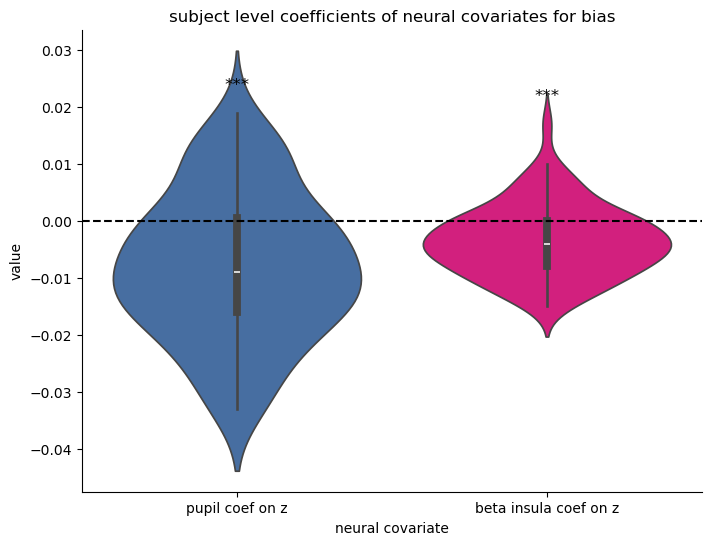

In [24]:
# Create a DataFrame for plotting
df = pd.DataFrame({
    'Data 1': zCoefPupilAllSubs['mean'],
    'Data 2': zCoefInsulaAllSubs['mean']
})

# Perform t-test against zero for each series
t_stat_pupil, p_value_pupil = stats.ttest_1samp(zCoefPupilAllSubs['mean'], 0)
t_stat_insula, p_value_insula = stats.ttest_1samp(zCoefInsulaAllSubs['mean'], 0)

# Significance threshold
alpha = 0.05

# Create the text for annotation based on p-values
annotation_pupil = 'Significant' if p_value_pupil < alpha else 'Not Significant'
annotation_insula = 'Significant' if p_value_insula < alpha else 'Not Significant'


# Melt the DataFrame to make it long-form (required for violinplot)
df_melted = df.melt(var_name='neural covariate', value_name='value')

# Use a colormap from Matplotlib
cmap = plt.get_cmap('Accent')  # Choose a colormap
colors = [cmap(4), cmap(5)]  # Extract specific colors from the colormap

# Create the violin plot with colormap colors
plt.figure(figsize=(8, 6))
ax =seaborn.violinplot(x='neural covariate', y='value', data=df_melted, palette=colors)

# Create labels for the data
labels = ['pupil coef on z', 'beta insula coef on z']

# Add a horizontal line at zero
plt.axhline(0, color='black', linestyle='--')

# Add labels and title
plt.xticks([0, 1], labels)
plt.xlabel('neural covariate')
plt.ylabel('value')
plt.title('subject level coefficients of neural covariates for bias')

def get_significance_asterisks(p_value):
    if p_value < 0.001:
        return '***'  # Very highly significant
    elif p_value < 0.01:
        return '**'   # Highly significant
    elif p_value < 0.05:
        return '*'    # Significant
    else:
        return 'ns'   # Not significant

# Get the significance level notation for both tests
pupil_significance = get_significance_asterisks(p_value_pupil)
insula_significance = get_significance_asterisks(p_value_insula)

ylim = ax.get_ylim()

# Calculate a suitable offset for the asterisk annotation (e.g., 5% above the max of the data range)
offset = (ylim[1] - ylim[0]) * 0.05  # 5% of the range as an offset

# Annotate the plot with * notation (positioned 5% above the maximum value on the violin)
ax.text(0, df['Data 1'].max() + offset, f'{pupil_significance}', ha='center', color='black', fontsize=12)
ax.text(1, df['Data 2'].max() + offset, f'{insula_significance}', ha='center', color='black', fontsize=12)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# Display the plot
plt.show()

### compute trial by trial bias

In [4]:
df = pd.read_csv(basepath+'/data/OB_singletrial_YAOA.csv')

df['response'] = df['accuracy']
# And then modify the 'response' column where the condition is met
df.loc[df['response'] == 0, 'response'] = -1

df.rename(columns={'reactiontime': 'rt'}, inplace=True)
df.rename(columns={'id': 'participant_id'}, inplace=True)

oddballDataDay2 = df[df['response'].notna()]

data=oddballDataDay2[:]
dataForModel = data[data['pupil'].notna()]

dataForModel = dataForModel.copy()
dataForModel = dataForModel[dataForModel['beta_insula'].notna()]

dataForModel['trl_condition'] = dataForModel['trl_condition'].astype('category')



In [70]:
ddm_model_hier_aFix_dependsTrl_trialNeuReg = hssm.HSSM(
    data=dataForModel,
    model="ddm",
    a=1.6,
    hierarchical=True,
    include=[
        {
            "name": "z",
            "formula": "z ~ 1 + (1|participant_id)+(trl_condition|participant_id)+(pupil|participant_id)+(beta_insula|participant_id)",
            "link": "identity",
        }
    ],    
)

Model initialized successfully.


In [69]:
ddm_inferenceData_aFix_bias_neuralCovariates.posterior

<xarray.Dataset> Size: 16MB
Dimensions:                                (chain: 2, draw: 2000,
                                            participant_id__factor_dim: 71,
                                            z_trl_condition__expr_dim: 2,
                                            v_1|participant_id__factor_dim: 71)
Coordinates:
  * chain                                  (chain) int64 16B 0 1
  * draw                                   (draw) int64 16kB 0 1 2 ... 1998 1999
  * participant_id__factor_dim             (participant_id__factor_dim) <U5 1kB ...
  * v_1|participant_id__factor_dim         (v_1|participant_id__factor_dim) <U5 1kB ...
  * z_trl_condition__expr_dim              (z_trl_condition__expr_dim) <U1 8B ...
Data variables: (12/24)
    t_1|participant_id                     (chain, draw, participant_id__factor_dim) float32 1MB ...
    z_beta_insula|participant_id_offset    (chain, draw, participant_id__factor_dim) float32 1MB ...
    z_pupil|participant_id_offset          (chain, draw, participant_id__factor_dim) float32 1MB ...
    z_pupil|participant_id_sigma           (chain, draw) float32 16kB 0.01779...
    z_beta_insula|participant_id           (chain, draw, participant_id__factor_dim) float32 1MB ...
    z_trl_condition|participant_id         (chain, draw, z_trl_condition__expr_dim, participant_id__factor_dim) float32 2MB ...
    ...                                     ...
    z_1|participant_id                     (chain, draw, participant_id__factor_dim) float32 1MB ...
    z_pupil|participant_id_mu              (chain, draw) float32 16kB 0.1581 ...
    z_trl_condition|participant_id_mu      (chain, draw, z_trl_condition__expr_dim) float32 32kB ...
    v_1|participant_id_sigma               (chain, draw) float32 16kB 0.644 ....
    z_Intercept                            (chain, draw) float32 16kB 0.5529 ...
    z_beta_insula|participant_id_sigma     (chain, draw) float32 16kB 0.01151...
Attributes:
    created_at:                  2024-09-16T11:03:48.763570+00:00
    arviz_version:               0.19.0
    inference_library:           numpyro
    inference_library_version:   0.15.2
    sampling_time:               458.746411
    tuning_steps:                5000
    modeling_interface:          bambi
    modeling_interface_version:  0.14.0

In [75]:
ddm_model_hier_aFix_dependsTrl_trialNeuReg._inference_obj=ddm_inferenceData_aFix_bias_neuralCovariates

In [76]:
ddm_model_hier_aFix_dependsTrl_trialNeuReg.sample_posterior_predictive()

idata=None, we use the traces assigned to the HSSM object as idata.


In [78]:
ddm_model_hier_aFix_dependsTrl_trialNeuReg.traces

Inference data with groups:
	> posterior
	> posterior_predictive
	> log_likelihood
	> sample_stats
	> observed_data

In [ ]:
loaded_traces = az.from_netcdef.... 
loaded_traces.posterior.sel(draw = #random subsample of the number of draws,
                            chain = #possible only pick two or so but doesn't matter that much)
inferenceData_ddm_aFix_hier._inference_obj = my_loaded_traces

inferenceData_ddm_aFix_hier.sample_posterior_predictive()

In [12]:
dataForModel

,id_runningnum,participant_id,agegrp,toi1,toi2,offset,trl_runningnum,event,trigger,artfree,...,beta_insula,beta_LC,pupil,LCr,trl_condition_bin,switch_condition,switch_condition_num,logreactiontime,logreactiontimez,response
0,1,42013,1,48306,50806,-1250,1,70,16,1,...,-0.010940,-0.997148,2.175158,0.985568,1,NaN,NaN,0.210081,1.375260,1.0
1,1,42013,1,52293,54793,-1250,2,74,16,1,...,-0.065556,-0.771706,-0.275299,0.985568,1,stay_standard,1.0,-0.174549,-0.033526,1.0
2,1,42013,1,54293,56793,-1250,3,78,16,1,...,0.509185,-0.017799,1.874566,0.985568,2,switch_to_oddball,3.0,0.289645,1.666682,1.0
3,1,42013,1,57293,59793,-1250,4,82,16,1,...,1.049503,-0.247686,-0.516399,0.985568,2,stay_oddball,2.0,0.296416,1.691481,1.0
4,1,42013,1,59293,61793,-1250,5,86,16,1,...,-0.611262,0.441441,0.710667,0.985568,1,switch_to_standard,4.0,-0.418396,-0.926666,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11284,77,62433,2,463649,466149,-1250,155,657,16,1,...,-0.901538,-1.274403,0.761824,0.386572,1,stay_standard,1.0,-0.137351,-0.110256,1.0
11285,77,62433,2,465649,468149,-1250,156,661,16,1,...,0.026958,-0.852999,-0.115871,0.386572,1,stay_standard,1.0,-0.197492,-0.575755,1.0
11286,77,62433,2,470649,473149,-1250,157,665,16,1,...,-0.940993,1.145411,1.098559,0.386572,2,switch_to_oddball,3.0,0.066526,1.467764,1.0
11287,77,62433,2,472649,475149,-1250,158,669,16,1,...,-0.779456,1.448574,-0.044915,0.386572,1,switch_to_standard,4.0,-0.082262,0.316131,1.0


In [14]:

print(dataForModel['trl_condition'].unique())

[1, 3, 2]
Categories (3, int64): [1, 2, 3]


In [15]:
print(dataForModel['trl_condition'].cat.categories)

Index([1, 2, 3], dtype='int64')


In [13]:
dataForModel['trl_condition']

0        1
1        1
2        3
3        2
4        1
        ..
11284    1
11285    1
11286    2
11287    1
11288    1
Name: trl_condition, Length: 11145, dtype: int64

In [59]:
ddm_inferenceData_aFix_bias_neuralCovariates

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [161]:
summary
summary.to_csv('summary_ddm_inference.csv', index=True)

In [60]:
summary = az.summary(ddm_inferenceData_aFix_bias_neuralCovariates)

z_intercept_mean = summary.loc['z_Intercept', 'mean']

z_random_intercept_means = summary.loc[summary.index.str.startswith('z_1|participant_id'), 'mean']


In [65]:
z_pupil_means = summary.loc[summary.index.str.startswith('z_pupil|participant_id'), 'mean']
z_beta_insula_means = summary.loc[summary.index.str.startswith('z_beta_insula|participant_id'), 'mean']


In [64]:
z_condition_means

z_trl_condition|participant_id[2, 42013]          -0.357
z_trl_condition|participant_id[2, 42023]          -0.214
z_trl_condition|participant_id[2, 42033]          -0.137
z_trl_condition|participant_id[2, 42043]          -0.204
z_trl_condition|participant_id[2, 42053]          -0.179
                                                   ...  
z_trl_condition|participant_id_offset[3, 62443]   -1.126
z_trl_condition|participant_id_sigma[2]            0.249
z_trl_condition|participant_id_sigma[3]            0.206
z_trl_condition|participant_id_mu[2]               0.054
z_trl_condition|participant_id_mu[3]              -0.046
Name: mean, Length: 288, dtype: float64

In [5]:
summary = az.summary(ddm_inferenceData_aFix_bias_neuralCovariates)

z_intercept_mean = summary.loc['z_Intercept', 'mean']

z_random_intercept_means = summary.loc[summary.index.str.startswith('z_1|participant_id'), 'mean']

z_condition_means = summary.loc[summary.index.str.startswith('z_trl_condition|participant_id'), 'mean']
z_pupil_means = summary.loc[summary.index.str.startswith('z_pupil|participant_id'), 'mean']
z_beta_insula_means = summary.loc[summary.index.str.startswith('z_beta_insula|participant_id'), 'mean']

bias_list = []

for index, row in dataForModel.iterrows():
    participant_id = row['participant_id']
    
    participant_intercept = z_intercept_mean + z_random_intercept_means[f'z_1|participant_id[{participant_id}]']
    participant_slope_trl2 = z_condition_means[f'z_trl_condition|participant_id[2, {participant_id}]']
    participant_slope_trl3 = z_condition_means[f'z_trl_condition|participant_id[3, {participant_id}]']
    participant_slope_pupil = z_pupil_means[f'z_pupil|participant_id[{participant_id}]']
    participant_slope_insula = z_beta_insula_means[f'z_beta_insula|participant_id[{participant_id}]']
    
   
    bias_value = (
        participant_intercept
        + participant_slope_trl2 * row['trl_condition']
        + participant_slope_trl3 * row['trl_condition']
        + participant_slope_pupil * row['pupil']
        + participant_slope_insula * row['beta_insula']
    )
    
    bias_list.append(bias_value)

dataForModel['bias'] = bias_list


In [7]:
dataForModel

,id_runningnum,participant_id,agegrp,toi1,toi2,offset,trl_runningnum,event,trigger,artfree,...,beta_LC,pupil,LCr,trl_condition_bin,switch_condition,switch_condition_num,logreactiontime,logreactiontimez,response,bias
0,1,42013,1,48306,50806,-1250,1,70,16,1,...,-0.997148,2.175158,0.985568,1,NaN,NaN,0.210081,1.375260,1.0,-0.206558
1,1,42013,1,52293,54793,-1250,2,74,16,1,...,-0.771706,-0.275299,0.985568,1,stay_standard,1.0,-0.174549,-0.033526,1.0,-0.157822
2,1,42013,1,54293,56793,-1250,3,78,16,1,...,-0.017799,1.874566,0.985568,2,switch_to_oddball,3.0,0.289645,1.666682,1.0,-1.999945
3,1,42013,1,57293,59793,-1250,4,82,16,1,...,-0.247686,-0.516399,0.985568,2,stay_oddball,2.0,0.296416,1.691481,1.0,-1.048425
4,1,42013,1,59293,61793,-1250,5,86,16,1,...,0.441441,0.710667,0.985568,1,switch_to_standard,4.0,-0.418396,-0.926666,1.0,-0.180270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11284,77,62433,2,463649,466149,-1250,155,657,16,1,...,-1.274403,0.761824,0.386572,1,stay_standard,1.0,-0.137351,-0.110256,1.0,0.171460
11285,77,62433,2,465649,468149,-1250,156,661,16,1,...,-0.852999,-0.115871,0.386572,1,stay_standard,1.0,-0.197492,-0.575755,1.0,0.170329
11286,77,62433,2,470649,473149,-1250,157,665,16,1,...,1.145411,1.098559,0.386572,2,switch_to_oddball,3.0,0.066526,1.467764,1.0,-0.173689
11287,77,62433,2,472649,475149,-1250,158,669,16,1,...,1.448574,-0.044915,0.386572,1,switch_to_standard,4.0,-0.082262,0.316131,1.0,0.174077


In [8]:

anova_model = ols('bias ~ C(trl_condition)', data=dataForModel).fit()
anova_table = sm.stats.anova_lm(anova_model, typ=2)
anova_table


,sum_sq,df,F,PR(>F)
C(trl_condition),872.356337,2.0,4712.762403,0.0
Residual,1031.220490,11142.0,NaN,NaN


/tmp/ipykernel_1429958/3037887979.py:8: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  dataForModel['trl_condition_labeled'] = dataForModel['trl_condition'].replace({1: 'Standard', 2: 'Fear', 3: 'Novel'})
/tmp/ipykernel_1429958/3037887979.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=seaborn.boxplot(x='trl_condition_labeled', y='bias', data=dataForModel, palette=colors_accent, order=trl_conditions)


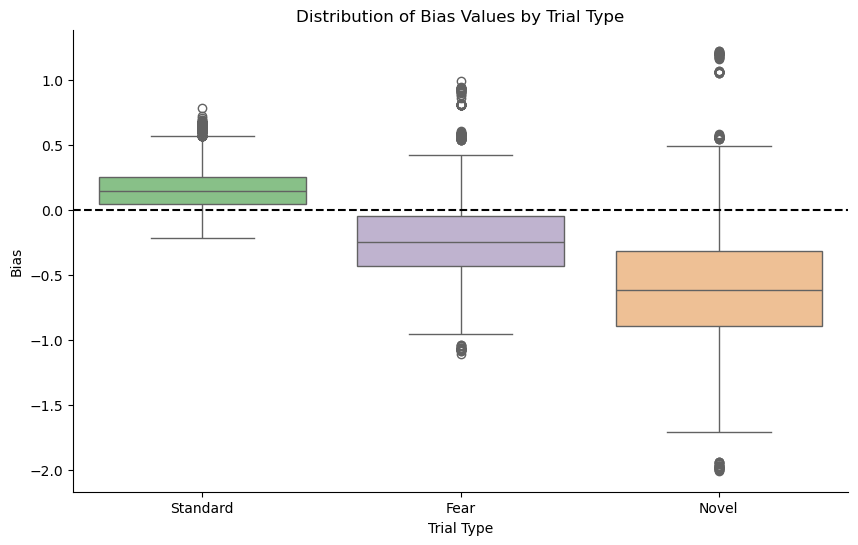

In [25]:
plt.figure(figsize=(10, 6))

cmap = plt.get_cmap('Accent')

trl_conditions = ['Standard', 'Fear', 'Novel']
colors_accent = [cmap(i) for i in range(len(trl_conditions))]

dataForModel['trl_condition_labeled'] = dataForModel['trl_condition'].replace({1: 'Standard', 2: 'Fear', 3: 'Novel'})


ax=seaborn.boxplot(x='trl_condition_labeled', y='bias', data=dataForModel, palette=colors_accent, order=trl_conditions)
plt.axhline(y=0, color='black', linestyle='--')
plt.title('Distribution of Bias Values by Trial Type')
plt.xlabel('Trial Type')
plt.ylabel('Bias')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [85]:
dataForModel.to_csv('dataForModel.csv', index=True)

# LBA neural covariate


In [37]:
fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_LBA_trialDepend_hier_Afix_neuralCovariates.nc'
lba_inferenceData_AFix_bias_neuralCovariates=az.from_netcdf(fileName)
lba_inferenceData_AFix_bias_neuralCovariates

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [38]:
s=az.summary(lba_inferenceData_AFix_bias_neuralCovariates,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         
                                         'v0_dummyV0',
                                         'v1_dummyV1',
                                         'v2_dummyV2',
                                         'v0_pupil|participant_id',
                                         'v1_pupil|participant_id',
                                         'v2_pupil|participant_id',
                                         'v0_beta_insula|participant_id',
                                         'v1_beta_insula|participant_id',
                                         'v2_beta_insula|participant_id'
                                         
                                         ])

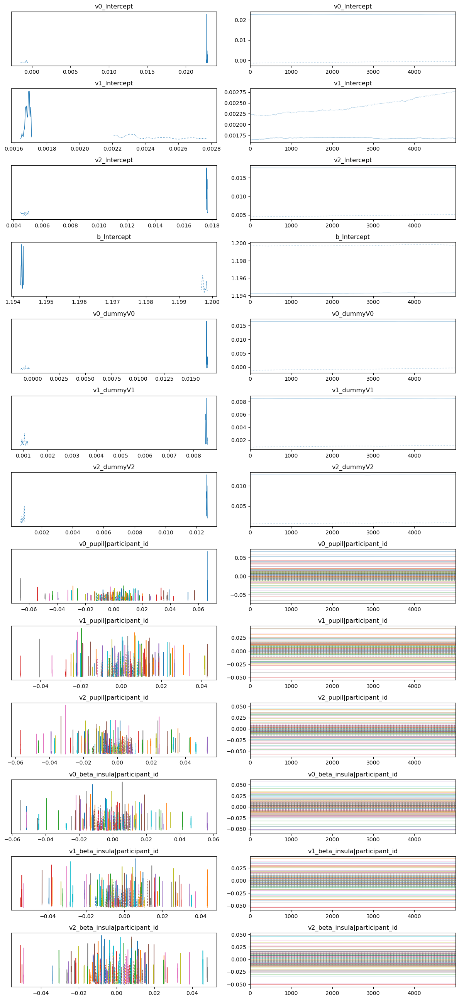

In [39]:
az.plot_trace(
    lba_inferenceData_AFix_bias_neuralCovariates,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         
                                         'v0_dummyV0',
                                         'v1_dummyV1',
                                         'v2_dummyV2',
                                         'v0_pupil|participant_id',
                                         'v1_pupil|participant_id',
                                         'v2_pupil|participant_id',
                                         'v0_beta_insula|participant_id',
                                         'v1_beta_insula|participant_id',
                                         'v2_beta_insula|participant_id'

                                         ],
                                         divergences=None
)
plt.tight_layout()

/users/afengler/data/software/miniconda3/envs/hssm_gpyou/lib/python3.11/site-packages/arviz/plots/backends/matplotlib/pairplot.py:233: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


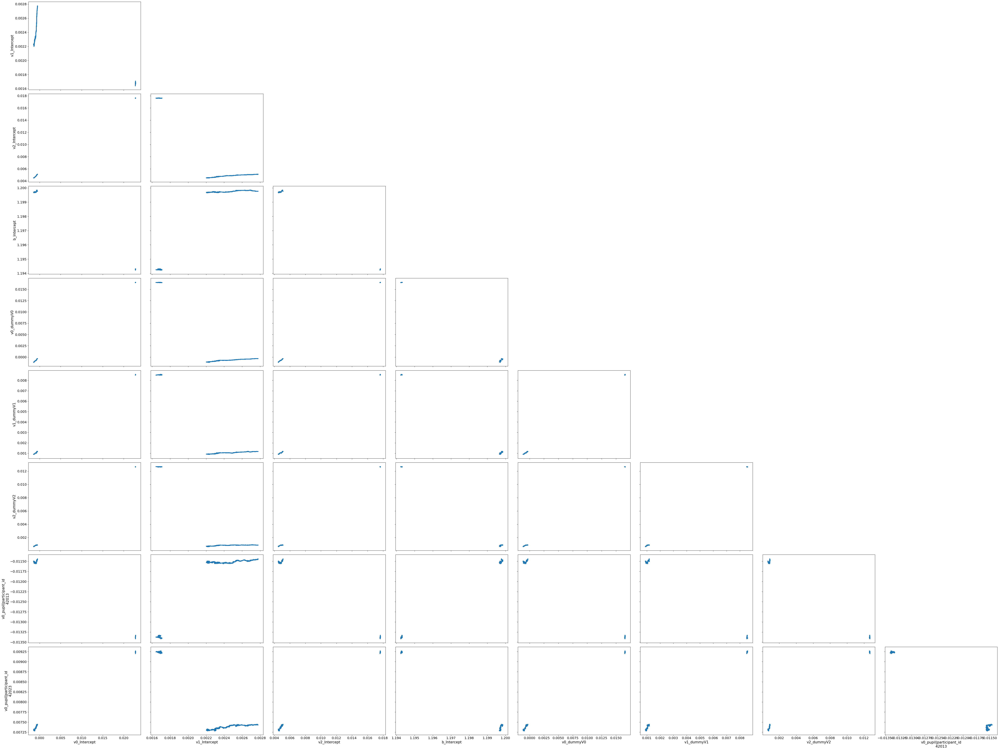

In [40]:
az.plot_pair(
    lba_inferenceData_AFix_bias_neuralCovariates,var_names=['v0_Intercept',
                                         'v1_Intercept',
                                         'v2_Intercept',
                                         'b_Intercept',
                                         
                                         'v0_dummyV0',
                                         'v1_dummyV1',
                                         'v2_dummyV2',
                                         'v0_pupil|participant_id',
                                         'v1_pupil|participant_id',
                                         'v2_pupil|participant_id',
                                         'v0_beta_insula|participant_id',
                                         'v1_beta_insula|participant_id',
                                         'v2_beta_insula|participant_id'

                                         
                                         ]
)
plt.tight_layout()

In [ ]:
fileName = basepath + '/models/ddm/sept24/numpyro/inferenceData_ddm_aFix_bias_neuralCovariates_.nc'
ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet=az.from_netcdf(fileName)
ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats
	> observed_data

In [ ]:
az.summary(ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_switch_condition_num'
                                         
                                         ])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
v_Intercept,4.327,0.097,4.162,4.506,0.017,0.013,28.0,106.0,1.06
z_Intercept,0.548,0.014,0.523,0.577,0.002,0.002,37.0,62.0,1.04
t_Intercept,0.448,0.009,0.433,0.465,0.002,0.001,33.0,40.0,1.07
z_pupil,-0.014,0.002,-0.017,-0.011,0.000,0.000,207.0,383.0,1.00
z_beta_insula,-0.008,0.002,-0.012,-0.005,0.000,0.000,131.0,302.0,1.01
z_switch_condition_num[2.0],-0.194,0.007,-0.208,-0.181,0.001,0.001,63.0,160.0,1.02
z_switch_condition_num[3.0],-0.237,0.005,-0.246,-0.227,0.001,0.000,97.0,312.0,1.02
z_switch_condition_num[4.0],-0.132,0.005,-0.141,-0.124,0.000,0.000,126.0,385.0,1.01


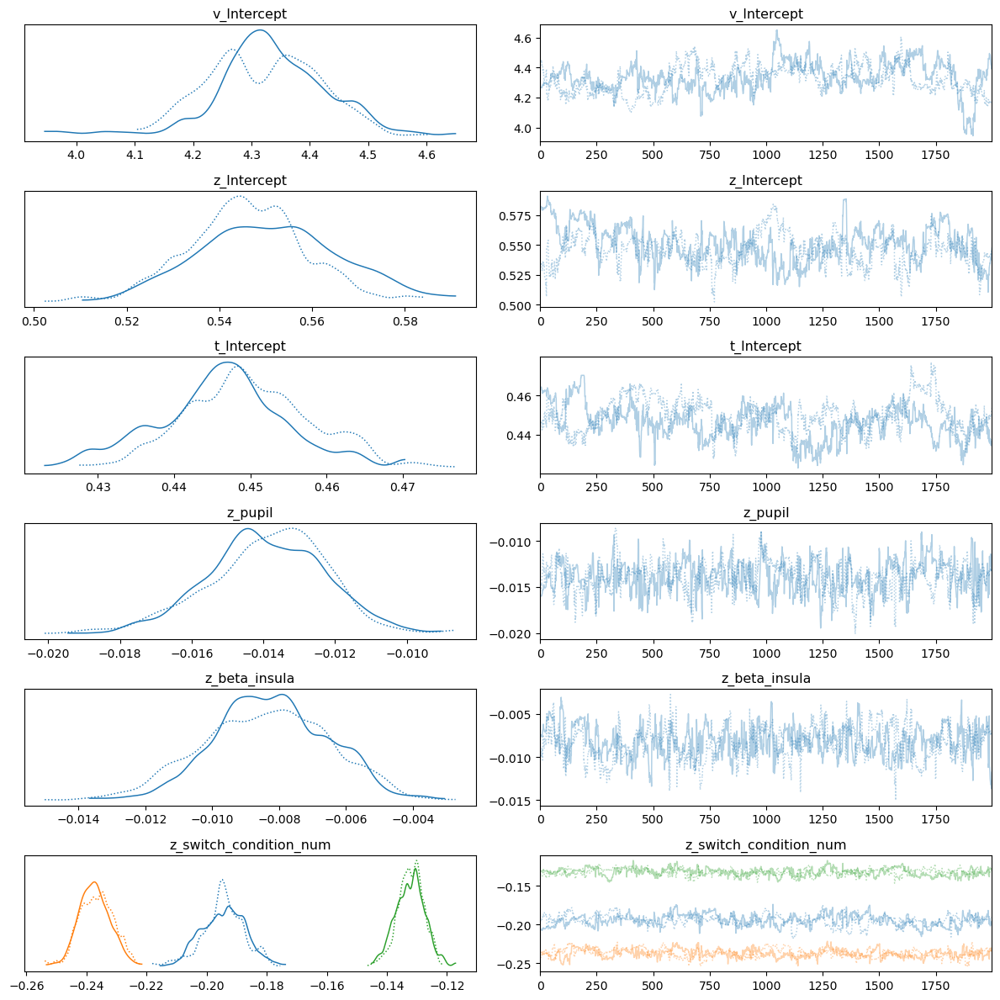

In [ ]:
az.plot_trace(
    ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_switch_condition_num'
                                         
                                         ],
                                         divergences=None
)
plt.tight_layout()

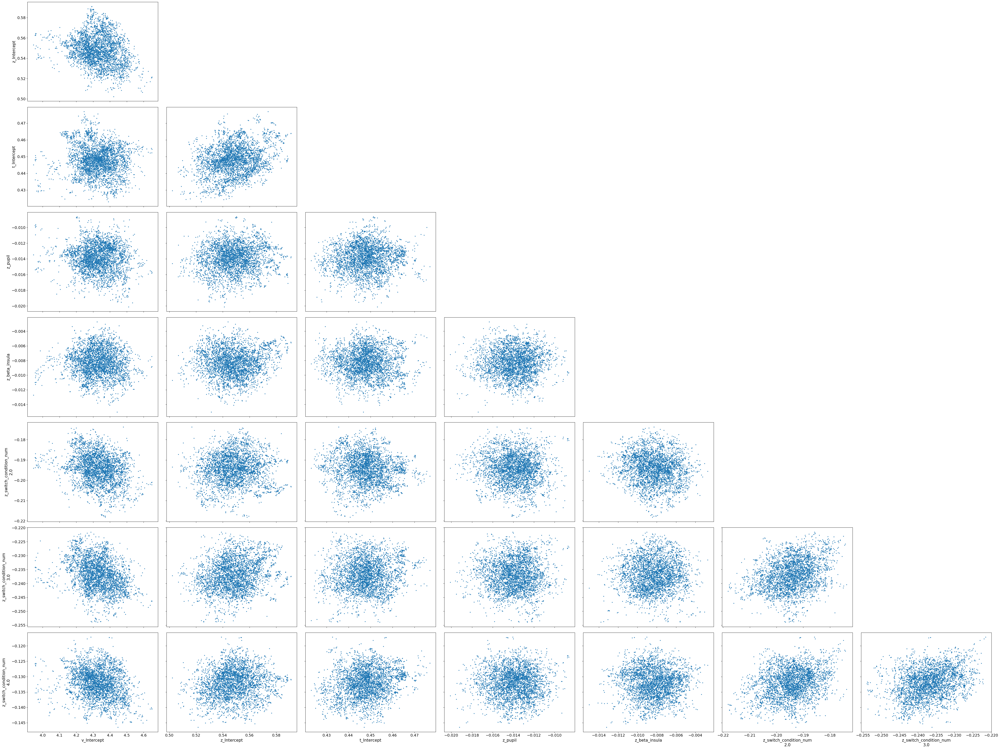

In [ ]:
az.plot_pair(
    ddm_inferenceData_aFix_bias_neuralCovariates_noOffSet,var_names=['v_Intercept',
                                         'z_Intercept',
                                         't_Intercept',
                                         'z_pupil',
                                         'z_beta_insula',
                                         'z_switch_condition_num'
                                         
                                         ]
)
plt.tight_layout()

In [4]:

fileName = basepath + '/models/lba/sept24/numpyro/inferenceData_sim_evenChoice_simple_LBA_model_hier_all_noPrior.nc'
inferenceData_simple_LBA_model_hier_all_noPrior=az.from_netcdf(fileName)
inferenceData_simple_LBA_model_hier_all_noPrior


Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

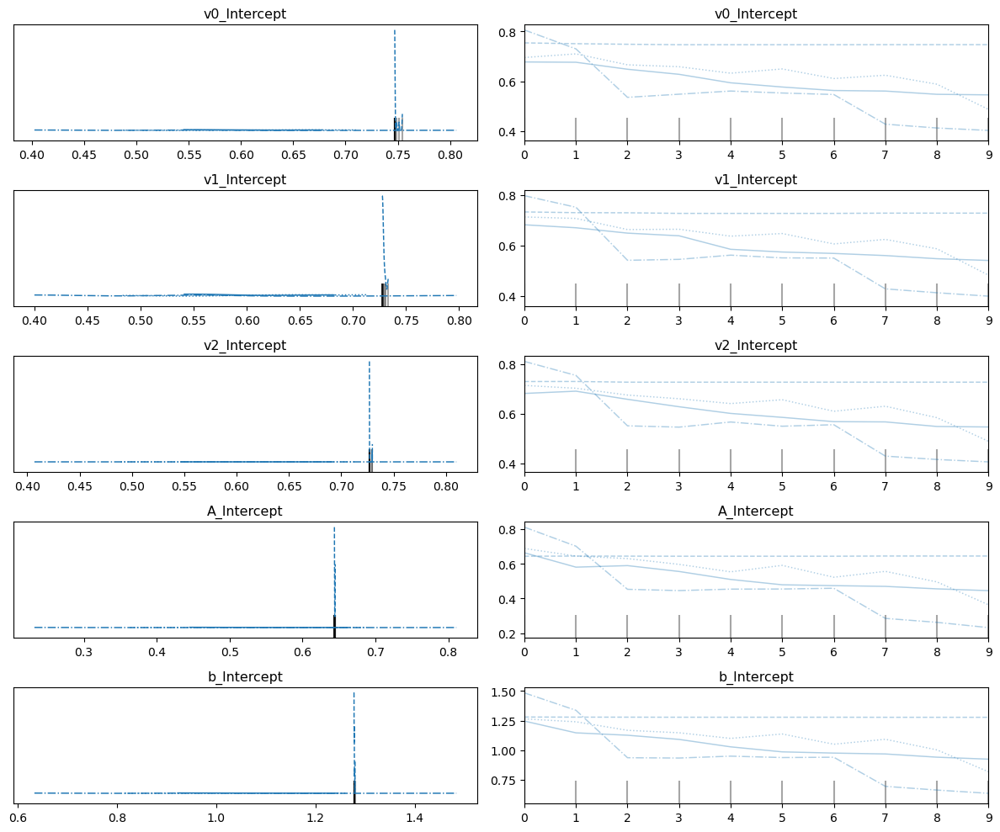

In [5]:
az.plot_trace(
    inferenceData_simple_LBA_model_hier_all_noPrior,var_names=['v0_Intercept','v1_Intercept',
                                                               'v2_Intercept', 'A_Intercept',
                                                               'b_Intercept']
)
plt.tight_layout()

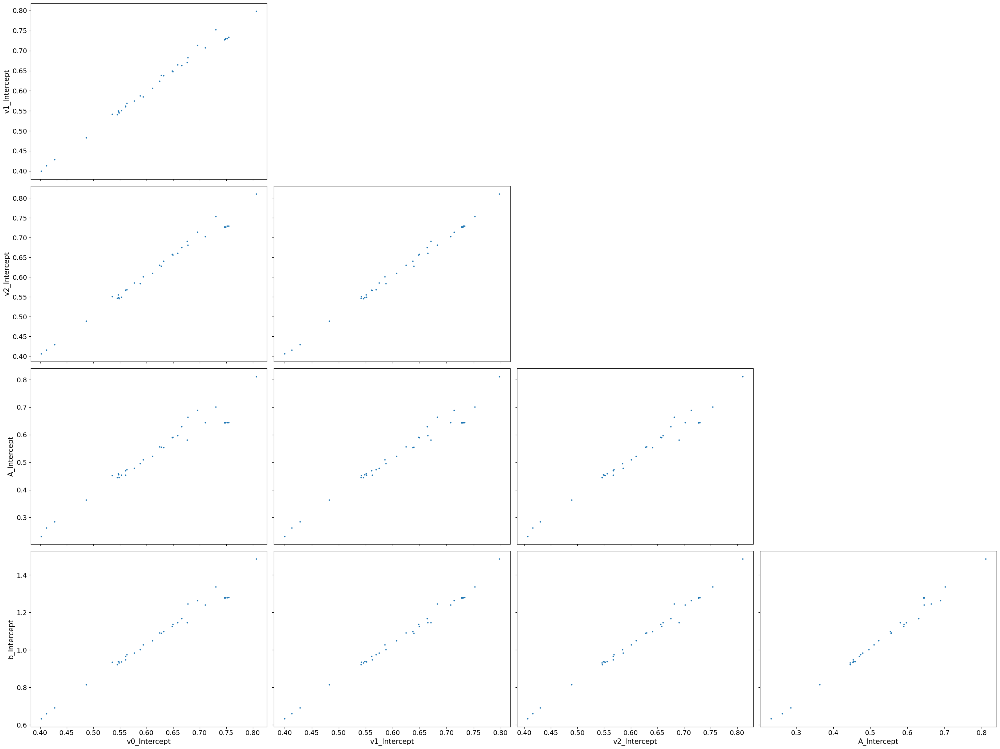

In [6]:
az.plot_pair(
    inferenceData_simple_LBA_model_hier_all_noPrior,var_names=['v0_Intercept','v1_Intercept',
                                                               'v2_Intercept', 'A_Intercept',
                                                               'b_Intercept']
)
plt.tight_layout()